This notebook is built for developing predictive models on the analyzed dataset.

Key steps:
- Prepare input and output data
- Regression Models
  - Linear Regression
  - Ridge Regression (with Hyperparameter Tuning)
  - Random Forest (with Hyperparameter Tuning)
  - XGBoost (with Hyperparameter Tuning)
  - CatBoost (with Hyperparameter Tuning)
  - LightGBM (with Hyperparameter Tuning)
- Training-validation Results
- Test Results
- XAI

Output:
- Benchmark Table for SDF Prediction (Training-Validation Data)
- Benchmark Table for SDF Prediction (Test Data)
- SHAP Summary Plot

In [ ]:
!pip install optuna
!pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 386.6/386.6 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.5/242.5 kB 18.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 9.3 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import RobustScaler
from sklearn.multioutput import MultiOutputRegressor
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
from lightgbm import LGBMRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import optuna
import joblib
import os

In [ ]:
# ==============================
# 1. Prepare Data
# ==============================

In [ ]:
data_reg = pd.read_pickle('05_engineered_data_reg.pkl')

In [ ]:
inputs_reg = data_reg.drop(columns=['DFI','TUNEL'])

# Identify numerical features (float64 and int64)
numerical_input_features_reg = inputs_reg.select_dtypes(include=['float64', 'int64']).columns.tolist()


# Identify categorical features (category and bool)
categorical_input_features_reg = inputs_reg.select_dtypes(include=['category', 'bool']).columns.tolist()

# Targets
numerical_targets = ['DFI','TUNEL']

In [ ]:
X_scaled_reg = pd.DataFrame(
    RobustScaler().fit_transform(data_reg[numerical_input_features_reg]),
    columns=numerical_input_features_reg,
    index=data_reg.index
)

In [ ]:
X_cat = pd.get_dummies(data_reg[categorical_input_features_reg], drop_first=True)

In [ ]:
#concatanate X_cat and X_scaled in data frame X
X_reg = pd.concat([X_scaled_reg, X_cat], axis=1)

In [ ]:
y_reg = data_reg[numerical_targets]

In [ ]:
# ==============================
# 2. Regression Utility
# ==============================

In [ ]:
# Adjusted R^2 calculation
def adjusted_r2(r2, n, p):
    return 1 - (1 - r2) * (n - 1) / (n - p - 1)

# Base evaluation function
def evaluate_regressor(model, X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    metrics = {target: {m: [] for m in ["mae", "mse", "rmse", "r2", "adj_r2"]} for target in y.columns}

    for train_index, test_index in kf.split(X):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        for idx, target in enumerate(y.columns):
            y_true_target = y_test.iloc[:, idx]
            y_pred_target = y_pred[:, idx]

            r2 = r2_score(y_true_target, y_pred_target)
            metrics[target]["mae"].append(mean_absolute_error(y_true_target, y_pred_target))
            metrics[target]["mse"].append(mean_squared_error(y_true_target, y_pred_target))
            metrics[target]["rmse"].append(np.sqrt(mean_squared_error(y_true_target, y_pred_target)))
            metrics[target]["r2"].append(r2)
            metrics[target]["adj_r2"].append(adjusted_r2(r2, len(y_test), X.shape[1]))

    return {
        target: {f"mean_{m}": np.mean(values) for m, values in m_dict.items()}
        for target, m_dict in metrics.items()
    }

In [ ]:
# ==============================
# 3. Regression Models
# ==============================

In [ ]:
# Linear Regression
def run_linear_regression(X, y):
    model = MultiOutputRegressor(LinearRegression())
    return model, evaluate_regressor(model, X, y)

# Polynomial Regression
def run_polynomial_regression(X, y, degree=2):
    poly = PolynomialFeatures(degree=degree)
    X_poly = pd.DataFrame(poly.fit_transform(X))
    model = MultiOutputRegressor(LinearRegression())
    return model, evaluate_regressor(model, X_poly, y), poly

# Ridge Regression
def run_ridge_regression(X, y, alpha=1.0):
    model = MultiOutputRegressor(Ridge(alpha=alpha))
    return model, evaluate_regressor(model, X, y)

# Optuna Ridge Objective
def ridge_objective(trial, X, y):
    alpha = trial.suggest_float('alpha', 0.01, 100.0, log=True)
    model = MultiOutputRegressor(Ridge(alpha=alpha))
    results = evaluate_regressor(model, X, y)
    return np.mean([results[target]["mean_rmse"] for target in results])

# Run Optuna
def optimize_ridge_with_optuna(X, y, n_trials=50):
    study = optuna.create_study(direction='minimize')
    study.optimize(lambda trial: ridge_objective(trial, X, y), n_trials=n_trials)
    return study


# Random Forest
def multi_output_random_forest(X, y, **rf_params):
    model = MultiOutputRegressor(
        RandomForestRegressor(**rf_params, random_state=42)
    )
    return model, evaluate_regressor(model, X, y)

# --- Optuna Objective ---
def rf_objective(trial, X, y):
    params = {
        "n_estimators": trial.suggest_int('n_estimators', 50, 500),
        "max_depth": trial.suggest_int('max_depth', 3, 20),
        "min_samples_split": trial.suggest_int('min_samples_split', 2, 10),
        "min_samples_leaf": trial.suggest_int('min_samples_leaf', 1, 10),
        "max_features": trial.suggest_categorical('max_features', ['sqrt', 'log2']),
    }

    model = MultiOutputRegressor(
        RandomForestRegressor(**params, random_state=42)
    )
    results = evaluate_regressor(model, X, y)
    mean_rmse = np.mean([results[target]["mean_rmse"] for target in results])
    return mean_rmse


# XGBoost
def multi_output_XGBoost(X, y, **xgb_params):
    model = MultiOutputRegressor(
        XGBRegressor(**xgb_params, random_state=42)
    )
    return model, evaluate_regressor(model, X, y)

# --- Optuna Objective ---
def xgb_objective(trial, X, y):
    params = {
        "n_estimators": trial.suggest_int('n_estimators', 50, 500),
        "max_depth": trial.suggest_int('max_depth', 3, 20),
        "learning_rate": trial.suggest_float('learning_rate', 0.01, 0.3),
        "subsample": trial.suggest_float('subsample', 0.6, 1.0),
        "colsample_bytree": trial.suggest_float('colsample_bytree', 0.6, 1.0),
        "gamma": trial.suggest_float('gamma', 1e-3, 1.0),
        "reg_alpha": trial.suggest_float('reg_alpha', 1e-3, 1.0),
        "reg_lambda": trial.suggest_float('reg_lambda', 1e-3, 1.0),
        "random_state": 42
    }

    model = MultiOutputRegressor(XGBRegressor(**params))
    results = evaluate_regressor(model, X, y)
    mean_rmse = np.mean([results[target]["mean_rmse"] for target in results])
    return mean_rmse

# CatBoost
def multi_output_CatBoost(X, y, **cat_params):
    model = MultiOutputRegressor(
        CatBoostRegressor(**cat_params, random_state=42)
    )
    return model, evaluate_regressor(model, X, y)

# --- Optuna Objective ---
def cat_objective(trial, X, y):
    params = {
        "n_estimators": trial.suggest_int('n_estimators', 50, 500),
        "max_depth": trial.suggest_int('max_depth', 3, 10),
        "learning_rate": trial.suggest_float('learning_rate', 0.01, 0.3, log=True),
        "l2_leaf_reg": trial.suggest_float('l2_leaf_reg', 1e-3, 10.0, log=True),
        "random_state": 42
    }

    model = MultiOutputRegressor(CatBoostRegressor(**params))
    results = evaluate_regressor(model, X, y)
    mean_rmse = np.mean([results[target]["mean_rmse"] for target in results])
    return mean_rmse



# LightGBM
def multi_output_lgbm(X, y, **lgbm_params):
    model = MultiOutputRegressor(
        LGBMRegressor(**lgbm_params, random_state=42)
    )
    return model, evaluate_regressor(model, X, y)

# --- Optuna Objective ---
def lgbm_objective(trial, X, y):
    params = {
        "n_estimators": trial.suggest_int('n_estimators', 50, 500),
        "max_depth": trial.suggest_int('max_depth', 3, 20),
        "learning_rate": trial.suggest_float('learning_rate', 0.01, 0.3, log=True),
        "num_leaves": trial.suggest_int('num_leaves', 20, 100),
        "min_child_samples": trial.suggest_int('min_child_samples', 10, 50),
        "subsample": trial.suggest_float('subsample', 0.6, 1.0),
        "colsample_bytree": trial.suggest_float('colsample_bytree', 0.6, 1.0),
        "reg_alpha": trial.suggest_float('reg_alpha', 0, 1.0),
        "reg_lambda": trial.suggest_float('reg_lambda', 0, 1.0),
        "random_state": 42
    }
    model = MultiOutputRegressor(LGBMRegressor(**params))
    results = evaluate_regressor(model, X, y)
    mean_rmse = np.mean([results[target]["mean_rmse"] for target in results])
    return mean_rmse

In [ ]:
os.makedirs("saved_models", exist_ok=True)

In [ ]:
# ==============================
# 4. Training-validation Results
# ==============================

In [ ]:
# results (linear regression, polynomial regression, ridge regression)
model_lr, results_lr = run_linear_regression(X_reg, y_reg)
joblib.dump(model_lr, "saved_models/linear_regression.pkl")

model_poly, results_poly, poly_transformer = run_polynomial_regression(X_reg, y_reg, degree=2)
joblib.dump(model_poly, "saved_models/polynomial_regression.pkl")
joblib.dump(poly_transformer, "saved_models/polynomial_transformer.pkl")

optuna_study = optimize_ridge_with_optuna(X_reg, y_reg)
best_alpha = optuna_study.best_params['alpha']
model_ridge, results_ridge = run_ridge_regression(X_reg, y_reg, alpha=best_alpha)
joblib.dump(model_ridge, "saved_models/ridge_regression.pkl")

[I 2025-06-03 15:52:26,341] A new study created in memory with name: no-name-36e2eb63-b10b-4794-91a3-09bee76633ef
[I 2025-06-03 15:52:26,613] Trial 0 finished with value: 6.344616492268152 and parameters: {'alpha': 0.2531709234378715}. Best is trial 0 with value: 6.344616492268152.
[I 2025-06-03 15:52:26,829] Trial 1 finished with value: 6.344603144223349 and parameters: {'alpha': 0.7454653686442382}. Best is trial 1 with value: 6.344603144223349.
[I 2025-06-03 15:52:27,043] Trial 2 finished with value: 6.344614492592253 and parameters: {'alpha': 0.32643287258513265}. Best is trial 1 with value: 6.344603144223349.
[I 2025-06-03 15:52:27,262] Trial 3 finished with value: 6.344622525361733 and parameters: {'alpha': 0.03316295712035183}. Best is trial 1 with value: 6.344603144223349.
[I 2025-06-03 15:52:27,519] Trial 4 finished with value: 6.34462218950685 and parameters: {'alpha': 0.045370299328605146}. Best is trial 1 with value: 6.344603144223349.
[I 2025-06-03 15:52:27,734] Trial 5 fi

['saved_models/ridge_regression.pkl']

In [ ]:
print(f"Linear Regression Results for DFI: MAE = {results_lr['DFI']['mean_mae']}, MSE = {results_lr['DFI']['mean_mse']}")
print(f"Linear Regression Results for TUNEL: MAE = {results_lr['TUNEL']['mean_mae']}, MSE = {results_lr['TUNEL']['mean_mse']}")
print(f"Polynomial Regression Results for DFI: MAE = {results_poly['DFI']['mean_mae']}, MSE = {results_poly['DFI']['mean_mse']}")
print(f"Polynomial Regression Results for TUNEL: MAE = {results_poly['TUNEL']['mean_mae']}, MSE = {results_poly['TUNEL']['mean_mse']}")
print(f"Ridge Regression Results for DFI: MAE = {results_ridge['DFI']['mean_mae']}, MSE = {results_ridge['DFI']['mean_mse']}")
print(f"Ridge Regression Results for TUNEL: MAE = {results_ridge['TUNEL']['mean_mae']}, MSE = {results_ridge['TUNEL']['mean_mse']}")

Linear Regression Results for DFI: MAE = 5.259991038404165, MSE = 48.877288985229555
Linear Regression Results for TUNEL: MAE = 3.8665659021581007, MSE = 32.56876288682982
Polynomial Regression Results for DFI: MAE = 5.242749031411388, MSE = 49.28510647114096
Polynomial Regression Results for TUNEL: MAE = 3.8799593505928818, MSE = 33.16412255147391
Ridge Regression Results for DFI: MAE = 5.259349878270477, MSE = 48.868312791098425
Ridge Regression Results for TUNEL: MAE = 3.8662732556088466, MSE = 32.56353181874531


In [ ]:
# results (random forest)
study = optuna.create_study(direction='minimize')
study.optimize(lambda trial: rf_objective(trial, X_reg, y_reg), n_trials=50)
model_rf, results_rf = multi_output_random_forest(X_reg, y_reg, **study.best_params)
joblib.dump(model_rf, "saved_models/random_forest.pkl")

[I 2025-06-03 09:17:50,523] A new study created in memory with name: no-name-15404150-bc69-4f5b-a2e2-837c40e23c47
[I 2025-06-03 09:20:29,909] Trial 0 finished with value: 6.304733051547271 and parameters: {'n_estimators': 473, 'max_depth': 10, 'min_samples_split': 5, 'min_samples_leaf': 5, 'max_features': 'log2'}. Best is trial 0 with value: 6.304733051547271.
[I 2025-06-03 09:21:19,556] Trial 1 finished with value: 6.315341200917702 and parameters: {'n_estimators': 131, 'max_depth': 18, 'min_samples_split': 8, 'min_samples_leaf': 9, 'max_features': 'log2'}. Best is trial 0 with value: 6.304733051547271.
[I 2025-06-03 09:22:08,756] Trial 2 finished with value: 6.311318675273424 and parameters: {'n_estimators': 158, 'max_depth': 10, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 'log2'}. Best is trial 0 with value: 6.304733051547271.
[I 2025-06-03 09:24:42,725] Trial 3 finished with value: 6.3325842604464295 and parameters: {'n_estimators': 322, 'max_depth': 20, 'min_sam

['saved_models/random_forest.pkl']

In [ ]:
print(f"Random Forest Results for DFI: MAE = {results_rf['DFI']['mean_mae']}, MSE = {results_rf['DFI']['mean_mse']}")
print(f"Random Forest Results for TUNEL: MAE = {results_rf['TUNEL']['mean_mae']}, MSE = {results_rf['TUNEL']['mean_mse']}")

Random Forest Results for DFI: MAE = 5.207551084652715, MSE = 48.15562954522245
Random Forest Results for TUNEL: MAE = 3.8411653933825205, MSE = 32.191684643761256


In [ ]:
# results (xgb)
study = optuna.create_study(direction='minimize')
study.optimize(lambda trial: xgb_objective(trial, X_reg, y_reg), n_trials=50)
model_xgb, results_xgb = multi_output_XGBoost(X_reg, y_reg, **study.best_params)
joblib.dump(model_xgb, "saved_models/xgboost.pkl")

[I 2025-06-03 11:13:15,428] A new study created in memory with name: no-name-76609641-0ebe-44e7-aa5e-1bd704969805
[I 2025-06-03 11:17:26,312] Trial 0 finished with value: 6.463793698538723 and parameters: {'n_estimators': 185, 'max_depth': 18, 'learning_rate': 0.022211699370253666, 'subsample': 0.8329892694254971, 'colsample_bytree': 0.6545107442180331, 'gamma': 0.3423210232503622, 'reg_alpha': 0.8473658121853834, 'reg_lambda': 0.39677674560942805}. Best is trial 0 with value: 6.463793698538723.
[I 2025-06-03 11:19:31,423] Trial 1 finished with value: 6.6053702152624485 and parameters: {'n_estimators': 153, 'max_depth': 19, 'learning_rate': 0.07392421213021318, 'subsample': 0.6075717942050529, 'colsample_bytree': 0.7493838292032549, 'gamma': 0.44068619291891664, 'reg_alpha': 0.4697826977416045, 'reg_lambda': 0.6569110960437194}. Best is trial 0 with value: 6.463793698538723.
[I 2025-06-03 11:20:27,292] Trial 2 finished with value: 6.757753555688101 and parameters: {'n_estimators': 252,

['saved_models/xgboost.pkl']

In [ ]:
print(f"XGBoost Results for DFI: MAE = {results_xgb['DFI']['mean_mae']}, MSE = {results_xgb['DFI']['mean_mse']}")
print(f"XGBoost Results for TUNEL: MAE = {results_xgb['TUNEL']['mean_mae']}, MSE = {results_xgb['TUNEL']['mean_mse']}")

XGBoost Results for DFI: MAE = 5.214551532753101, MSE = 48.35144493693892
XGBoost Results for TUNEL: MAE = 3.841553728409443, MSE = 32.268452978523264


In [ ]:
# results (catboost)
study = optuna.create_study(direction='minimize')
study.optimize(lambda trial: cat_objective(trial, X_reg, y_reg), n_trials=50)
model_cat, results_cat = multi_output_CatBoost(X_reg, y_reg, **study.best_params)
joblib.dump(model_cat, "saved_models/catboost.pkl")

[I 2025-06-03 12:35:43,408] A new study created in memory with name: no-name-91ac26c7-3d37-4607-9db5-3a69bcb14333


0:	learn: 7.4810010	total: 4.44ms	remaining: 293ms
1:	learn: 7.4346159	total: 7.6ms	remaining: 247ms
2:	learn: 7.3942527	total: 10.4ms	remaining: 222ms
3:	learn: 7.3601377	total: 13.2ms	remaining: 207ms
4:	learn: 7.3212164	total: 16.2ms	remaining: 201ms
5:	learn: 7.2877188	total: 19ms	remaining: 193ms
6:	learn: 7.2580317	total: 21.9ms	remaining: 187ms
7:	learn: 7.2289287	total: 24.5ms	remaining: 181ms
8:	learn: 7.2055646	total: 27.9ms	remaining: 180ms
9:	learn: 7.1809489	total: 30.6ms	remaining: 175ms
10:	learn: 7.1578083	total: 33.4ms	remaining: 170ms
11:	learn: 7.1374546	total: 36.2ms	remaining: 166ms
12:	learn: 7.1174651	total: 38.8ms	remaining: 161ms
13:	learn: 7.0999405	total: 41.5ms	remaining: 157ms
14:	learn: 7.0826442	total: 44.9ms	remaining: 156ms
15:	learn: 7.0672677	total: 47.6ms	remaining: 152ms
16:	learn: 7.0530996	total: 50.6ms	remaining: 149ms
17:	learn: 7.0401334	total: 53.2ms	remaining: 145ms
18:	learn: 7.0268150	total: 56ms	remaining: 141ms
19:	learn: 7.0135139	total:

[I 2025-06-03 12:35:48,610] Trial 0 finished with value: 6.32172635505026 and parameters: {'n_estimators': 67, 'max_depth': 5, 'learning_rate': 0.0695413853272502, 'l2_leaf_reg': 0.030743217933004628}. Best is trial 0 with value: 6.32172635505026.


51:	learn: 5.5050838	total: 149ms	remaining: 43ms
52:	learn: 5.5007469	total: 155ms	remaining: 41ms
53:	learn: 5.4977089	total: 158ms	remaining: 38ms
54:	learn: 5.4944074	total: 163ms	remaining: 35.5ms
55:	learn: 5.4897168	total: 165ms	remaining: 32.5ms
56:	learn: 5.4847054	total: 168ms	remaining: 29.5ms
57:	learn: 5.4802334	total: 170ms	remaining: 26.5ms
58:	learn: 5.4783111	total: 173ms	remaining: 23.5ms
59:	learn: 5.4755077	total: 176ms	remaining: 20.5ms
60:	learn: 5.4724566	total: 178ms	remaining: 17.5ms
61:	learn: 5.4673302	total: 181ms	remaining: 14.6ms
62:	learn: 5.4628479	total: 184ms	remaining: 11.7ms
63:	learn: 5.4588635	total: 186ms	remaining: 8.72ms
64:	learn: 5.4543163	total: 189ms	remaining: 5.81ms
65:	learn: 5.4512130	total: 192ms	remaining: 2.9ms
66:	learn: 5.4481792	total: 194ms	remaining: 0us
0:	learn: 7.5123739	total: 24.9ms	remaining: 1.27s
1:	learn: 7.4933617	total: 42.4ms	remaining: 1.06s
2:	learn: 7.4770372	total: 62.5ms	remaining: 1.02s
3:	learn: 7.4623445	total

[I 2025-06-03 12:36:11,902] Trial 1 finished with value: 6.445102026685156 and parameters: {'n_estimators': 52, 'max_depth': 9, 'learning_rate': 0.023832077169883607, 'l2_leaf_reg': 9.193261446104817}. Best is trial 0 with value: 6.32172635505026.


Streaming output truncated to the last 5000 lines.
90:	learn: 6.9565427	total: 262ms	remaining: 966ms
91:	learn: 6.9540253	total: 264ms	remaining: 962ms
92:	learn: 6.9511584	total: 267ms	remaining: 958ms
93:	learn: 6.9491878	total: 270ms	remaining: 955ms
94:	learn: 6.9473341	total: 272ms	remaining: 952ms
95:	learn: 6.9453183	total: 275ms	remaining: 948ms
96:	learn: 6.9435456	total: 278ms	remaining: 945ms
97:	learn: 6.9412290	total: 281ms	remaining: 942ms
98:	learn: 6.9391431	total: 283ms	remaining: 938ms
99:	learn: 6.9377784	total: 286ms	remaining: 935ms
100:	learn: 6.9354110	total: 289ms	remaining: 932ms
101:	learn: 6.9333570	total: 291ms	remaining: 929ms
102:	learn: 6.9314546	total: 294ms	remaining: 925ms
103:	learn: 6.9295008	total: 297ms	remaining: 922ms
104:	learn: 6.9273532	total: 300ms	remaining: 919ms
105:	learn: 6.9254662	total: 303ms	remaining: 916ms
106:	learn: 6.9230661	total: 305ms	remaining: 913ms
107:	learn: 6.9206534	total: 308ms	remaining: 910ms
108:	learn: 6.9189769	t

[I 2025-06-03 12:36:42,825] Trial 2 finished with value: 6.311255243079199 and parameters: {'n_estimators': 427, 'max_depth': 5, 'learning_rate': 0.021376985148064357, 'l2_leaf_reg': 0.002704831963975714}. Best is trial 2 with value: 6.311255243079199.


393:	learn: 5.3034049	total: 1.19s	remaining: 99.5ms
394:	learn: 5.3022087	total: 1.19s	remaining: 96.8ms
395:	learn: 5.3015269	total: 1.2s	remaining: 94ms
396:	learn: 5.3007020	total: 1.2s	remaining: 91ms
397:	learn: 5.3000312	total: 1.21s	remaining: 87.9ms
398:	learn: 5.2994248	total: 1.21s	remaining: 84.9ms
399:	learn: 5.2986132	total: 1.21s	remaining: 81.9ms
400:	learn: 5.2980374	total: 1.22s	remaining: 78.8ms
401:	learn: 5.2972728	total: 1.22s	remaining: 75.8ms
402:	learn: 5.2964805	total: 1.22s	remaining: 72.7ms
403:	learn: 5.2959168	total: 1.22s	remaining: 69.7ms
404:	learn: 5.2955638	total: 1.23s	remaining: 66.7ms
405:	learn: 5.2942118	total: 1.23s	remaining: 63.6ms
406:	learn: 5.2935849	total: 1.23s	remaining: 60.6ms
407:	learn: 5.2929978	total: 1.24s	remaining: 57.6ms
408:	learn: 5.2925547	total: 1.24s	remaining: 54.5ms
409:	learn: 5.2919116	total: 1.24s	remaining: 51.5ms
410:	learn: 5.2914631	total: 1.24s	remaining: 48.4ms
411:	learn: 5.2911481	total: 1.25s	remaining: 45.4ms

[I 2025-06-03 12:37:39,991] Trial 3 finished with value: 6.40641922703618 and parameters: {'n_estimators': 220, 'max_depth': 8, 'learning_rate': 0.09651057268031853, 'l2_leaf_reg': 0.8404480087356051}. Best is trial 2 with value: 6.311255243079199.


Streaming output truncated to the last 5000 lines.
267:	learn: 5.4128308	total: 513ms	remaining: 264ms
268:	learn: 5.4122438	total: 515ms	remaining: 262ms
269:	learn: 5.4114505	total: 517ms	remaining: 260ms
270:	learn: 5.4104553	total: 519ms	remaining: 258ms
271:	learn: 5.4101513	total: 520ms	remaining: 256ms
272:	learn: 5.4095823	total: 522ms	remaining: 254ms
273:	learn: 5.4088899	total: 523ms	remaining: 252ms
274:	learn: 5.4082461	total: 525ms	remaining: 250ms
275:	learn: 5.4072658	total: 527ms	remaining: 248ms
276:	learn: 5.4059975	total: 528ms	remaining: 246ms
277:	learn: 5.4051156	total: 530ms	remaining: 244ms
278:	learn: 5.4042101	total: 531ms	remaining: 242ms
279:	learn: 5.4033329	total: 533ms	remaining: 240ms
280:	learn: 5.4021560	total: 534ms	remaining: 238ms
281:	learn: 5.4014940	total: 536ms	remaining: 236ms
282:	learn: 5.4009654	total: 538ms	remaining: 234ms
283:	learn: 5.4002293	total: 539ms	remaining: 232ms
284:	learn: 5.3993359	total: 541ms	remaining: 230ms
285:	learn: 5

[I 2025-06-03 12:37:58,024] Trial 4 finished with value: 6.32938446085063 and parameters: {'n_estimators': 406, 'max_depth': 3, 'learning_rate': 0.046254345170851724, 'l2_leaf_reg': 0.00697275570096185}. Best is trial 2 with value: 6.311255243079199.


395:	learn: 5.3283620	total: 710ms	remaining: 17.9ms
396:	learn: 5.3271301	total: 713ms	remaining: 16.2ms
397:	learn: 5.3264015	total: 715ms	remaining: 14.4ms
398:	learn: 5.3258966	total: 723ms	remaining: 12.7ms
399:	learn: 5.3253843	total: 725ms	remaining: 10.9ms
400:	learn: 5.3244173	total: 732ms	remaining: 9.12ms
401:	learn: 5.3239706	total: 733ms	remaining: 7.3ms
402:	learn: 5.3234379	total: 735ms	remaining: 5.47ms
403:	learn: 5.3226977	total: 736ms	remaining: 3.65ms
404:	learn: 5.3220176	total: 738ms	remaining: 1.82ms
405:	learn: 5.3211676	total: 740ms	remaining: 0us
0:	learn: 7.3702707	total: 3.84ms	remaining: 561ms
1:	learn: 7.2480908	total: 6.7ms	remaining: 486ms
2:	learn: 7.1637146	total: 9.99ms	remaining: 479ms
3:	learn: 7.1029942	total: 12.7ms	remaining: 455ms
4:	learn: 7.0489297	total: 15.4ms	remaining: 438ms
5:	learn: 7.0140301	total: 18.2ms	remaining: 427ms
6:	learn: 6.9773601	total: 20.8ms	remaining: 416ms
7:	learn: 6.9541924	total: 23.5ms	remaining: 409ms
8:	learn: 6.93

[I 2025-06-03 12:38:10,002] Trial 5 finished with value: 6.465948524289377 and parameters: {'n_estimators': 147, 'max_depth': 5, 'learning_rate': 0.24497454248101744, 'l2_leaf_reg': 0.07927591824225258}. Best is trial 2 with value: 6.311255243079199.


Streaming output truncated to the last 5000 lines.
220:	learn: 5.0570860	total: 1.47s	remaining: 1.68s
221:	learn: 5.0563252	total: 1.47s	remaining: 1.68s
222:	learn: 5.0550850	total: 1.48s	remaining: 1.67s
223:	learn: 5.0525606	total: 1.48s	remaining: 1.66s
224:	learn: 5.0499078	total: 1.49s	remaining: 1.66s
225:	learn: 5.0483983	total: 1.5s	remaining: 1.65s
226:	learn: 5.0459116	total: 1.5s	remaining: 1.64s
227:	learn: 5.0434179	total: 1.51s	remaining: 1.63s
228:	learn: 5.0399350	total: 1.51s	remaining: 1.62s
229:	learn: 5.0379956	total: 1.52s	remaining: 1.62s
230:	learn: 5.0373562	total: 1.52s	remaining: 1.61s
231:	learn: 5.0359048	total: 1.53s	remaining: 1.6s
232:	learn: 5.0350351	total: 1.53s	remaining: 1.59s
233:	learn: 5.0335392	total: 1.54s	remaining: 1.59s
234:	learn: 5.0306234	total: 1.55s	remaining: 1.58s
235:	learn: 5.0285323	total: 1.56s	remaining: 1.58s
236:	learn: 5.0274340	total: 1.57s	remaining: 1.58s
237:	learn: 5.0254183	total: 1.57s	remaining: 1.57s
238:	learn: 5.02

[I 2025-06-03 12:39:25,476] Trial 6 finished with value: 6.382193619504278 and parameters: {'n_estimators': 475, 'max_depth': 7, 'learning_rate': 0.07975590885302378, 'l2_leaf_reg': 8.23887741547095}. Best is trial 2 with value: 6.311255243079199.


Streaming output truncated to the last 5000 lines.
300:	learn: 4.8840148	total: 4.8s	remaining: 2.25s
301:	learn: 4.8795768	total: 4.81s	remaining: 2.23s
302:	learn: 4.8766485	total: 4.82s	remaining: 2.21s
303:	learn: 4.8728280	total: 4.83s	remaining: 2.19s
304:	learn: 4.8681987	total: 4.84s	remaining: 2.17s
305:	learn: 4.8590755	total: 4.86s	remaining: 2.16s
306:	learn: 4.8569264	total: 4.88s	remaining: 2.15s
307:	learn: 4.8519050	total: 4.89s	remaining: 2.13s
308:	learn: 4.8462130	total: 4.9s	remaining: 2.11s
309:	learn: 4.8431110	total: 4.91s	remaining: 2.09s
310:	learn: 4.8367621	total: 4.92s	remaining: 2.07s
311:	learn: 4.8331123	total: 4.93s	remaining: 2.05s
312:	learn: 4.8288383	total: 4.94s	remaining: 2.04s
313:	learn: 4.8229200	total: 4.95s	remaining: 2.02s
314:	learn: 4.8195042	total: 4.96s	remaining: 2s
315:	learn: 4.8172243	total: 4.97s	remaining: 1.98s
316:	learn: 4.8110906	total: 4.98s	remaining: 1.96s
317:	learn: 4.8068563	total: 4.99s	remaining: 1.95s
318:	learn: 4.8003

[I 2025-06-03 12:41:19,071] Trial 7 finished with value: 6.500374269886812 and parameters: {'n_estimators': 442, 'max_depth': 8, 'learning_rate': 0.08502848700491974, 'l2_leaf_reg': 0.026588410770703695}. Best is trial 2 with value: 6.311255243079199.


Streaming output truncated to the last 5000 lines.
119:	learn: 5.3250593	total: 2.42s	remaining: 6.18s
120:	learn: 5.3167862	total: 2.43s	remaining: 6.16s
121:	learn: 5.3103144	total: 2.45s	remaining: 6.13s
122:	learn: 5.2987010	total: 2.47s	remaining: 6.1s
123:	learn: 5.2895375	total: 2.49s	remaining: 6.08s
124:	learn: 5.2752071	total: 2.52s	remaining: 6.09s
125:	learn: 5.2688632	total: 2.54s	remaining: 6.07s
126:	learn: 5.2667198	total: 2.56s	remaining: 6.04s
127:	learn: 5.2540925	total: 2.57s	remaining: 6.01s
128:	learn: 5.2461174	total: 2.59s	remaining: 5.98s
129:	learn: 5.2406091	total: 2.61s	remaining: 5.96s
130:	learn: 5.2301613	total: 2.63s	remaining: 5.93s
131:	learn: 5.2230188	total: 2.64s	remaining: 5.91s
132:	learn: 5.2144100	total: 2.66s	remaining: 5.88s
133:	learn: 5.2049394	total: 2.68s	remaining: 5.86s
134:	learn: 5.1961176	total: 2.69s	remaining: 5.83s
135:	learn: 5.1887378	total: 2.71s	remaining: 5.8s
136:	learn: 5.1832383	total: 2.74s	remaining: 5.8s
137:	learn: 5.17

[I 2025-06-03 12:44:30,496] Trial 8 finished with value: 6.618154996302566 and parameters: {'n_estimators': 427, 'max_depth': 9, 'learning_rate': 0.1732718984655239, 'l2_leaf_reg': 2.491647134534581}. Best is trial 2 with value: 6.311255243079199.


422:	learn: 2.5109255	total: 8.22s	remaining: 77.8ms
423:	learn: 2.5073867	total: 8.26s	remaining: 58.4ms
424:	learn: 2.5025194	total: 8.28s	remaining: 38.9ms
425:	learn: 2.4958350	total: 8.3s	remaining: 19.5ms
426:	learn: 2.4919416	total: 8.34s	remaining: 0us
0:	learn: 7.5068269	total: 55.8ms	remaining: 11.4s
1:	learn: 7.4828134	total: 89.9ms	remaining: 9.17s
2:	learn: 7.4603576	total: 124ms	remaining: 8.36s
3:	learn: 7.4347077	total: 155ms	remaining: 7.83s
4:	learn: 7.4131137	total: 192ms	remaining: 7.71s
5:	learn: 7.3911173	total: 226ms	remaining: 7.52s
6:	learn: 7.3689096	total: 263ms	remaining: 7.48s
7:	learn: 7.3486571	total: 317ms	remaining: 7.84s
8:	learn: 7.3293063	total: 355ms	remaining: 7.78s
9:	learn: 7.3109559	total: 391ms	remaining: 7.67s
10:	learn: 7.2935165	total: 425ms	remaining: 7.53s
11:	learn: 7.2767831	total: 471ms	remaining: 7.61s
12:	learn: 7.2618901	total: 527ms	remaining: 7.82s
13:	learn: 7.2437213	total: 571ms	remaining: 7.83s
14:	learn: 7.2253279	total: 604ms

[I 2025-06-03 12:46:04,665] Trial 9 finished with value: 6.322207053140907 and parameters: {'n_estimators': 206, 'max_depth': 9, 'learning_rate': 0.02324413680408288, 'l2_leaf_reg': 0.026596607016113927}. Best is trial 2 with value: 6.311255243079199.


Streaming output truncated to the last 5000 lines.
81:	learn: 5.7898892	total: 137ms	remaining: 430ms
82:	learn: 5.7878922	total: 138ms	remaining: 428ms
83:	learn: 5.7865125	total: 140ms	remaining: 427ms
84:	learn: 5.7844423	total: 142ms	remaining: 425ms
85:	learn: 5.7823992	total: 143ms	remaining: 423ms
86:	learn: 5.7804112	total: 145ms	remaining: 421ms
87:	learn: 5.7783886	total: 146ms	remaining: 420ms
88:	learn: 5.7764782	total: 148ms	remaining: 418ms
89:	learn: 5.7751671	total: 150ms	remaining: 417ms
90:	learn: 5.7736673	total: 152ms	remaining: 415ms
91:	learn: 5.7721703	total: 153ms	remaining: 413ms
92:	learn: 5.7706858	total: 155ms	remaining: 411ms
93:	learn: 5.7688454	total: 156ms	remaining: 409ms
94:	learn: 5.7673307	total: 158ms	remaining: 408ms
95:	learn: 5.7658849	total: 160ms	remaining: 406ms
96:	learn: 5.7641558	total: 161ms	remaining: 405ms
97:	learn: 5.7627376	total: 163ms	remaining: 403ms
98:	learn: 5.7614698	total: 165ms	remaining: 401ms
99:	learn: 5.7597510	total: 166

[I 2025-06-03 12:46:21,996] Trial 10 finished with value: 6.336999056874143 and parameters: {'n_estimators': 340, 'max_depth': 3, 'learning_rate': 0.01227571232439364, 'l2_leaf_reg': 0.0010039824792511508}. Best is trial 2 with value: 6.311255243079199.


Streaming output truncated to the last 5000 lines.
309:	learn: 6.4028111	total: 998ms	remaining: 74.1ms
310:	learn: 6.4008826	total: 1.01s	remaining: 71.2ms
311:	learn: 6.3989642	total: 1.01s	remaining: 68.1ms
312:	learn: 6.3978696	total: 1.01s	remaining: 64.8ms
313:	learn: 6.3965442	total: 1.02s	remaining: 61.6ms
314:	learn: 6.3951814	total: 1.02s	remaining: 58.4ms
315:	learn: 6.3938076	total: 1.03s	remaining: 55.2ms
316:	learn: 6.3917536	total: 1.03s	remaining: 51.9ms
317:	learn: 6.3906425	total: 1.03s	remaining: 48.7ms
318:	learn: 6.3884905	total: 1.04s	remaining: 45.5ms
319:	learn: 6.3871337	total: 1.04s	remaining: 42.2ms
320:	learn: 6.3859031	total: 1.04s	remaining: 39ms
321:	learn: 6.3848358	total: 1.05s	remaining: 35.8ms
322:	learn: 6.3835719	total: 1.05s	remaining: 32.5ms
323:	learn: 6.3824274	total: 1.05s	remaining: 29.3ms
324:	learn: 6.3811905	total: 1.06s	remaining: 26ms
325:	learn: 6.3792245	total: 1.06s	remaining: 22.8ms
326:	learn: 6.3774962	total: 1.06s	remaining: 19.5ms

[I 2025-06-03 12:46:49,634] Trial 11 finished with value: 6.330253598214535 and parameters: {'n_estimators': 333, 'max_depth': 5, 'learning_rate': 0.041967013285602386, 'l2_leaf_reg': 0.0018904162621446252}. Best is trial 2 with value: 6.311255243079199.


314:	learn: 5.1194152	total: 1.01s	remaining: 58ms
315:	learn: 5.1175275	total: 1.02s	remaining: 55.1ms
316:	learn: 5.1159074	total: 1.03s	remaining: 52ms
317:	learn: 5.1147523	total: 1.04s	remaining: 49ms
318:	learn: 5.1135855	total: 1.05s	remaining: 46ms
319:	learn: 5.1121701	total: 1.06s	remaining: 42.9ms
320:	learn: 5.1110804	total: 1.06s	remaining: 39.7ms
321:	learn: 5.1097769	total: 1.06s	remaining: 36.4ms
322:	learn: 5.1085213	total: 1.07s	remaining: 33.1ms
323:	learn: 5.1074215	total: 1.07s	remaining: 29.7ms
324:	learn: 5.1060371	total: 1.07s	remaining: 26.4ms
325:	learn: 5.1047051	total: 1.08s	remaining: 23.1ms
326:	learn: 5.1030190	total: 1.08s	remaining: 19.8ms
327:	learn: 5.1013847	total: 1.08s	remaining: 16.5ms
328:	learn: 5.1004730	total: 1.08s	remaining: 13.2ms
329:	learn: 5.0987483	total: 1.09s	remaining: 9.88ms
330:	learn: 5.0977700	total: 1.09s	remaining: 6.58ms
331:	learn: 5.0962577	total: 1.09s	remaining: 3.29ms
332:	learn: 5.0949705	total: 1.09s	remaining: 0us
0:	l

[I 2025-06-03 12:46:55,019] Trial 12 finished with value: 6.527651418870958 and parameters: {'n_estimators': 66, 'max_depth': 5, 'learning_rate': 0.010330668226699742, 'l2_leaf_reg': 0.005428847717877963}. Best is trial 2 with value: 6.311255243079199.


Streaming output truncated to the last 5000 lines.
199:	learn: 5.3365153	total: 976ms	remaining: 517ms
200:	learn: 5.3348544	total: 979ms	remaining: 512ms
201:	learn: 5.3335880	total: 983ms	remaining: 506ms
202:	learn: 5.3320873	total: 987ms	remaining: 501ms
203:	learn: 5.3299450	total: 991ms	remaining: 495ms
204:	learn: 5.3287891	total: 995ms	remaining: 490ms
205:	learn: 5.3272742	total: 999ms	remaining: 485ms
206:	learn: 5.3261794	total: 1s	remaining: 479ms
207:	learn: 5.3253519	total: 1.01s	remaining: 474ms
208:	learn: 5.3243486	total: 1.01s	remaining: 469ms
209:	learn: 5.3228401	total: 1.01s	remaining: 463ms
210:	learn: 5.3215404	total: 1.02s	remaining: 458ms
211:	learn: 5.3208211	total: 1.02s	remaining: 453ms
212:	learn: 5.3197162	total: 1.02s	remaining: 448ms
213:	learn: 5.3179471	total: 1.03s	remaining: 442ms
214:	learn: 5.3160847	total: 1.03s	remaining: 437ms
215:	learn: 5.3144209	total: 1.04s	remaining: 432ms
216:	learn: 5.3130753	total: 1.04s	remaining: 427ms
217:	learn: 5.31

[I 2025-06-03 12:47:31,109] Trial 13 finished with value: 6.313378400277209 and parameters: {'n_estimators': 306, 'max_depth': 6, 'learning_rate': 0.02606453781744753, 'l2_leaf_reg': 0.27898073049727085}. Best is trial 2 with value: 6.311255243079199.


Streaming output truncated to the last 5000 lines.
112:	learn: 5.5338007	total: 1.3s	remaining: 2.18s
113:	learn: 5.5319851	total: 1.31s	remaining: 2.16s
114:	learn: 5.5299929	total: 1.33s	remaining: 2.16s
115:	learn: 5.5276195	total: 1.34s	remaining: 2.15s
116:	learn: 5.5258409	total: 1.35s	remaining: 2.13s
117:	learn: 5.5231537	total: 1.36s	remaining: 2.13s
118:	learn: 5.5211766	total: 1.38s	remaining: 2.12s
119:	learn: 5.5195580	total: 1.39s	remaining: 2.11s
120:	learn: 5.5181888	total: 1.4s	remaining: 2.1s
121:	learn: 5.5158566	total: 1.41s	remaining: 2.09s
122:	learn: 5.5142141	total: 1.43s	remaining: 2.07s
123:	learn: 5.5119484	total: 1.44s	remaining: 2.06s
124:	learn: 5.5101248	total: 1.45s	remaining: 2.06s
125:	learn: 5.5080825	total: 1.46s	remaining: 2.05s
126:	learn: 5.5063893	total: 1.48s	remaining: 2.04s
127:	learn: 5.5043318	total: 1.49s	remaining: 2.02s
128:	learn: 5.5024525	total: 1.5s	remaining: 2.02s
129:	learn: 5.4994742	total: 1.51s	remaining: 2s
130:	learn: 5.497600

[I 2025-06-03 12:48:07,744] Trial 14 finished with value: 6.314156484318936 and parameters: {'n_estimators': 302, 'max_depth': 6, 'learning_rate': 0.02123298033026278, 'l2_leaf_reg': 0.2945002432059857}. Best is trial 2 with value: 6.311255243079199.


Streaming output truncated to the last 5000 lines.
260:	learn: 6.6826964	total: 728ms	remaining: 323ms
261:	learn: 6.6822378	total: 730ms	remaining: 320ms
262:	learn: 6.6811840	total: 732ms	remaining: 317ms
263:	learn: 6.6802466	total: 734ms	remaining: 314ms
264:	learn: 6.6794091	total: 736ms	remaining: 311ms
265:	learn: 6.6783352	total: 738ms	remaining: 308ms
266:	learn: 6.6776857	total: 740ms	remaining: 305ms
267:	learn: 6.6765845	total: 742ms	remaining: 302ms
268:	learn: 6.6756508	total: 744ms	remaining: 299ms
269:	learn: 6.6745087	total: 746ms	remaining: 296ms
270:	learn: 6.6731507	total: 748ms	remaining: 293ms
271:	learn: 6.6722064	total: 751ms	remaining: 290ms
272:	learn: 6.6712360	total: 753ms	remaining: 287ms
273:	learn: 6.6702322	total: 755ms	remaining: 284ms
274:	learn: 6.6692352	total: 758ms	remaining: 281ms
275:	learn: 6.6685521	total: 760ms	remaining: 278ms
276:	learn: 6.6675492	total: 764ms	remaining: 276ms
277:	learn: 6.6667000	total: 766ms	remaining: 273ms
278:	learn: 6

[I 2025-06-03 12:48:33,253] Trial 15 finished with value: 6.316762626041408 and parameters: {'n_estimators': 377, 'max_depth': 4, 'learning_rate': 0.03390460783056002, 'l2_leaf_reg': 0.1614880415347524}. Best is trial 2 with value: 6.311255243079199.


Streaming output truncated to the last 5000 lines.
434:	learn: 5.2623349	total: 3.54s	remaining: 481ms
435:	learn: 5.2615192	total: 3.55s	remaining: 472ms
436:	learn: 5.2608034	total: 3.55s	remaining: 464ms
437:	learn: 5.2604649	total: 3.56s	remaining: 455ms
438:	learn: 5.2599837	total: 3.56s	remaining: 447ms
439:	learn: 5.2592017	total: 3.57s	remaining: 438ms
440:	learn: 5.2580867	total: 3.58s	remaining: 431ms
441:	learn: 5.2574638	total: 3.6s	remaining: 424ms
442:	learn: 5.2567693	total: 3.61s	remaining: 416ms
443:	learn: 5.2563214	total: 3.63s	remaining: 409ms
444:	learn: 5.2553909	total: 3.65s	remaining: 401ms
445:	learn: 5.2544837	total: 3.65s	remaining: 393ms
446:	learn: 5.2540350	total: 3.66s	remaining: 385ms
447:	learn: 5.2533984	total: 3.66s	remaining: 376ms
448:	learn: 5.2526495	total: 3.67s	remaining: 368ms
449:	learn: 5.2522517	total: 3.67s	remaining: 359ms
450:	learn: 5.2514993	total: 3.68s	remaining: 351ms
451:	learn: 5.2507659	total: 3.69s	remaining: 342ms
452:	learn: 5.

[I 2025-06-03 12:50:01,879] Trial 16 finished with value: 6.309483798265655 and parameters: {'n_estimators': 494, 'max_depth': 7, 'learning_rate': 0.01415543261416019, 'l2_leaf_reg': 1.072792119637031}. Best is trial 16 with value: 6.309483798265655.


Streaming output truncated to the last 5000 lines.
344:	learn: 5.3190882	total: 4.26s	remaining: 1.75s
345:	learn: 5.3183598	total: 4.28s	remaining: 1.74s
346:	learn: 5.3170421	total: 4.29s	remaining: 1.73s
347:	learn: 5.3161308	total: 4.31s	remaining: 1.72s
348:	learn: 5.3154907	total: 4.32s	remaining: 1.71s
349:	learn: 5.3145809	total: 4.35s	remaining: 1.7s
350:	learn: 5.3140001	total: 4.37s	remaining: 1.69s
351:	learn: 5.3129272	total: 4.38s	remaining: 1.68s
352:	learn: 5.3120825	total: 4.4s	remaining: 1.67s
353:	learn: 5.3110772	total: 4.41s	remaining: 1.66s
354:	learn: 5.3104751	total: 4.43s	remaining: 1.65s
355:	learn: 5.3098378	total: 4.45s	remaining: 1.64s
356:	learn: 5.3088212	total: 4.46s	remaining: 1.63s
357:	learn: 5.3075971	total: 4.48s	remaining: 1.61s
358:	learn: 5.3071047	total: 4.5s	remaining: 1.6s
359:	learn: 5.3057317	total: 4.51s	remaining: 1.59s
360:	learn: 5.3047600	total: 4.53s	remaining: 1.58s
361:	learn: 5.3042363	total: 4.54s	remaining: 1.57s
362:	learn: 5.303

[I 2025-06-03 12:51:35,195] Trial 17 finished with value: 6.308569519188477 and parameters: {'n_estimators': 487, 'max_depth': 7, 'learning_rate': 0.015217656911539945, 'l2_leaf_reg': 1.2975422790485267}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
465:	learn: 5.2681844	total: 3.68s	remaining: 253ms
466:	learn: 5.2670115	total: 3.69s	remaining: 245ms
467:	learn: 5.2664506	total: 3.7s	remaining: 237ms
468:	learn: 5.2659645	total: 3.7s	remaining: 229ms
469:	learn: 5.2651131	total: 3.71s	remaining: 221ms
470:	learn: 5.2643608	total: 3.72s	remaining: 213ms
471:	learn: 5.2636685	total: 3.73s	remaining: 205ms
472:	learn: 5.2631933	total: 3.74s	remaining: 198ms
473:	learn: 5.2626697	total: 3.74s	remaining: 190ms
474:	learn: 5.2621516	total: 3.75s	remaining: 182ms
475:	learn: 5.2613947	total: 3.77s	remaining: 174ms
476:	learn: 5.2607778	total: 3.79s	remaining: 167ms
477:	learn: 5.2602479	total: 3.79s	remaining: 159ms
478:	learn: 5.2597456	total: 3.8s	remaining: 151ms
479:	learn: 5.2586627	total: 3.8s	remaining: 143ms
480:	learn: 5.2583247	total: 3.81s	remaining: 135ms
481:	learn: 5.2576025	total: 3.81s	remaining: 127ms
482:	learn: 5.2568526	total: 3.82s	remaining: 119ms
483:	learn: 5.256

[I 2025-06-03 12:53:09,730] Trial 18 finished with value: 6.309144758769364 and parameters: {'n_estimators': 498, 'max_depth': 7, 'learning_rate': 0.014197767041616316, 'l2_leaf_reg': 1.721466325501392}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
353:	learn: 5.2436103	total: 5.47s	remaining: 2.06s
354:	learn: 5.2421740	total: 5.48s	remaining: 2.04s
355:	learn: 5.2417532	total: 5.49s	remaining: 2.02s
356:	learn: 5.2409304	total: 5.5s	remaining: 2s
357:	learn: 5.2402231	total: 5.51s	remaining: 1.99s
358:	learn: 5.2395501	total: 5.52s	remaining: 1.97s
359:	learn: 5.2382739	total: 5.53s	remaining: 1.95s
360:	learn: 5.2375344	total: 5.54s	remaining: 1.93s
361:	learn: 5.2366629	total: 5.55s	remaining: 1.92s
362:	learn: 5.2359717	total: 5.56s	remaining: 1.9s
363:	learn: 5.2350091	total: 5.57s	remaining: 1.88s
364:	learn: 5.2341048	total: 5.58s	remaining: 1.86s
365:	learn: 5.2334539	total: 5.58s	remaining: 1.85s
366:	learn: 5.2321720	total: 5.6s	remaining: 1.83s
367:	learn: 5.2311043	total: 5.63s	remaining: 1.82s
368:	learn: 5.2304365	total: 5.65s	remaining: 1.81s
369:	learn: 5.2295327	total: 5.68s	remaining: 1.8s
370:	learn: 5.2282243	total: 5.69s	remaining: 1.78s
371:	learn: 5.227417

[I 2025-06-03 12:55:36,150] Trial 19 finished with value: 6.314477446415756 and parameters: {'n_estimators': 487, 'max_depth': 8, 'learning_rate': 0.015941975896881865, 'l2_leaf_reg': 2.575652033472823}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
274:	learn: 6.2313187	total: 11.9s	remaining: 4.41s
275:	learn: 6.2293815	total: 11.9s	remaining: 4.37s
276:	learn: 6.2269730	total: 12s	remaining: 4.32s
277:	learn: 6.2243927	total: 12s	remaining: 4.28s
278:	learn: 6.2229502	total: 12s	remaining: 4.23s
279:	learn: 6.2206573	total: 12.1s	remaining: 4.18s
280:	learn: 6.2185785	total: 12.1s	remaining: 4.15s
281:	learn: 6.2174730	total: 12.2s	remaining: 4.11s
282:	learn: 6.2161329	total: 12.2s	remaining: 4.06s
283:	learn: 6.2136029	total: 12.3s	remaining: 4.01s
284:	learn: 6.2108373	total: 12.3s	remaining: 3.96s
285:	learn: 6.2089045	total: 12.3s	remaining: 3.92s
286:	learn: 6.2071210	total: 12.3s	remaining: 3.87s
287:	learn: 6.2052305	total: 12.4s	remaining: 3.83s
288:	learn: 6.2034475	total: 12.5s	remaining: 3.79s
289:	learn: 6.2014343	total: 12.5s	remaining: 3.75s
290:	learn: 6.1998778	total: 12.5s	remaining: 3.7s
291:	learn: 6.1983983	total: 12.5s	remaining: 3.65s
292:	learn: 6.195773

[I 2025-06-03 13:01:04,567] Trial 20 finished with value: 6.327552447982326 and parameters: {'n_estimators': 377, 'max_depth': 10, 'learning_rate': 0.017301571912973008, 'l2_leaf_reg': 2.1262665842755917}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
416:	learn: 5.2447223	total: 5.45s	remaining: 994ms
417:	learn: 5.2440298	total: 5.46s	remaining: 980ms
418:	learn: 5.2430220	total: 5.47s	remaining: 966ms
419:	learn: 5.2425691	total: 5.47s	remaining: 952ms
420:	learn: 5.2419421	total: 5.48s	remaining: 938ms
421:	learn: 5.2412421	total: 5.49s	remaining: 924ms
422:	learn: 5.2404900	total: 5.5s	remaining: 910ms
423:	learn: 5.2398827	total: 5.5s	remaining: 896ms
424:	learn: 5.2391893	total: 5.51s	remaining: 882ms
425:	learn: 5.2386606	total: 5.52s	remaining: 868ms
426:	learn: 5.2380464	total: 5.53s	remaining: 854ms
427:	learn: 5.2372233	total: 5.53s	remaining: 841ms
428:	learn: 5.2367599	total: 5.54s	remaining: 827ms
429:	learn: 5.2355611	total: 5.55s	remaining: 814ms
430:	learn: 5.2348695	total: 5.57s	remaining: 801ms
431:	learn: 5.2339429	total: 5.57s	remaining: 787ms
432:	learn: 5.2330754	total: 5.58s	remaining: 773ms
433:	learn: 5.2323024	total: 5.58s	remaining: 759ms
434:	learn: 5.2

[I 2025-06-03 13:02:44,147] Trial 21 finished with value: 6.310826960450525 and parameters: {'n_estimators': 493, 'max_depth': 7, 'learning_rate': 0.014900557226456942, 'l2_leaf_reg': 0.8710791123290134}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
60:	learn: 5.8289188	total: 537ms	remaining: 3.51s
61:	learn: 5.8248839	total: 542ms	remaining: 3.48s
62:	learn: 5.8212554	total: 548ms	remaining: 3.45s
63:	learn: 5.8178094	total: 553ms	remaining: 3.42s
64:	learn: 5.8140154	total: 559ms	remaining: 3.4s
65:	learn: 5.8106941	total: 564ms	remaining: 3.37s
66:	learn: 5.8069021	total: 570ms	remaining: 3.34s
67:	learn: 5.8038933	total: 575ms	remaining: 3.32s
68:	learn: 5.8001042	total: 581ms	remaining: 3.29s
69:	learn: 5.7968065	total: 588ms	remaining: 3.27s
70:	learn: 5.7929643	total: 594ms	remaining: 3.25s
71:	learn: 5.7893943	total: 602ms	remaining: 3.25s
72:	learn: 5.7861400	total: 608ms	remaining: 3.22s
73:	learn: 5.7825693	total: 614ms	remaining: 3.2s
74:	learn: 5.7799611	total: 626ms	remaining: 3.21s
75:	learn: 5.7764403	total: 639ms	remaining: 3.23s
76:	learn: 5.7731310	total: 653ms	remaining: 3.25s
77:	learn: 5.7702242	total: 671ms	remaining: 3.29s
78:	learn: 5.7675032	total: 690ms

[I 2025-06-03 13:04:20,129] Trial 22 finished with value: 6.311176472715934 and parameters: {'n_estimators': 460, 'max_depth': 7, 'learning_rate': 0.01100553232169902, 'l2_leaf_reg': 0.8396553853389733}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
475:	learn: 5.1451324	total: 2.86s	remaining: 132ms
476:	learn: 5.1445349	total: 2.86s	remaining: 126ms
477:	learn: 5.1442262	total: 2.87s	remaining: 120ms
478:	learn: 5.1432615	total: 2.87s	remaining: 114ms
479:	learn: 5.1425978	total: 2.88s	remaining: 108ms
480:	learn: 5.1419181	total: 2.88s	remaining: 102ms
481:	learn: 5.1409090	total: 2.88s	remaining: 95.7ms
482:	learn: 5.1403346	total: 2.89s	remaining: 89.7ms
483:	learn: 5.1394187	total: 2.89s	remaining: 83.6ms
484:	learn: 5.1387050	total: 2.89s	remaining: 77.6ms
485:	learn: 5.1379609	total: 2.9s	remaining: 71.6ms
486:	learn: 5.1367144	total: 2.9s	remaining: 65.5ms
487:	learn: 5.1360728	total: 2.9s	remaining: 59.5ms
488:	learn: 5.1351078	total: 2.91s	remaining: 53.5ms
489:	learn: 5.1345827	total: 2.92s	remaining: 47.6ms
490:	learn: 5.1338051	total: 2.92s	remaining: 41.7ms
491:	learn: 5.1329520	total: 2.93s	remaining: 35.8ms
492:	learn: 5.1324166	total: 2.95s	remaining: 29.9ms
493:

[I 2025-06-03 13:05:29,173] Trial 23 finished with value: 6.3218292887053 and parameters: {'n_estimators': 498, 'max_depth': 6, 'learning_rate': 0.03164188929315413, 'l2_leaf_reg': 4.1020516178785975}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
155:	learn: 5.4800632	total: 2.62s	remaining: 4.05s
156:	learn: 5.4786852	total: 2.64s	remaining: 4.03s
157:	learn: 5.4772968	total: 2.65s	remaining: 4.01s
158:	learn: 5.4754945	total: 2.67s	remaining: 4s
159:	learn: 5.4742256	total: 2.69s	remaining: 3.98s
160:	learn: 5.4724823	total: 2.71s	remaining: 3.97s
161:	learn: 5.4705113	total: 2.73s	remaining: 3.96s
162:	learn: 5.4683907	total: 2.74s	remaining: 3.94s
163:	learn: 5.4666734	total: 2.76s	remaining: 3.92s
164:	learn: 5.4647330	total: 2.77s	remaining: 3.9s
165:	learn: 5.4636568	total: 2.79s	remaining: 3.88s
166:	learn: 5.4618263	total: 2.8s	remaining: 3.86s
167:	learn: 5.4600786	total: 2.82s	remaining: 3.85s
168:	learn: 5.4582076	total: 2.84s	remaining: 3.83s
169:	learn: 5.4566572	total: 2.86s	remaining: 3.82s
170:	learn: 5.4550433	total: 2.88s	remaining: 3.8s
171:	learn: 5.4535965	total: 2.89s	remaining: 3.79s
172:	learn: 5.4521917	total: 2.92s	remaining: 3.78s
173:	learn: 5.45103

[I 2025-06-03 13:06:55,001] Trial 24 finished with value: 6.3094239032468 and parameters: {'n_estimators': 397, 'max_depth': 7, 'learning_rate': 0.014321155121204934, 'l2_leaf_reg': 0.6425033226927634}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
56:	learn: 5.6383197	total: 851ms	remaining: 4.95s
57:	learn: 5.6331121	total: 864ms	remaining: 4.93s
58:	learn: 5.6294593	total: 873ms	remaining: 4.88s
59:	learn: 5.6245835	total: 882ms	remaining: 4.84s
60:	learn: 5.6191815	total: 892ms	remaining: 4.8s
61:	learn: 5.6135805	total: 901ms	remaining: 4.75s
62:	learn: 5.6087277	total: 911ms	remaining: 4.71s
63:	learn: 5.6037460	total: 920ms	remaining: 4.67s
64:	learn: 5.5993902	total: 929ms	remaining: 4.63s
65:	learn: 5.5945177	total: 939ms	remaining: 4.59s
66:	learn: 5.5896632	total: 949ms	remaining: 4.56s
67:	learn: 5.5848975	total: 965ms	remaining: 4.56s
68:	learn: 5.5808903	total: 992ms	remaining: 4.6s
69:	learn: 5.5764905	total: 1.01s	remaining: 4.62s
70:	learn: 5.5717608	total: 1.04s	remaining: 4.67s
71:	learn: 5.5680972	total: 1.07s	remaining: 4.71s
72:	learn: 5.5644489	total: 1.1s	remaining: 4.77s
73:	learn: 5.5601646	total: 1.13s	remaining: 4.79s
74:	learn: 5.5561343	total: 1.15s	

[I 2025-06-03 13:09:08,273] Trial 25 finished with value: 6.316774292705187 and parameters: {'n_estimators': 389, 'max_depth': 8, 'learning_rate': 0.018799846708219756, 'l2_leaf_reg': 0.485407250571275}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
388:	learn: 6.3249700	total: 2.45s	remaining: 377ms
389:	learn: 6.3240687	total: 2.45s	remaining: 371ms
390:	learn: 6.3222152	total: 2.45s	remaining: 364ms
391:	learn: 6.3209229	total: 2.46s	remaining: 357ms
392:	learn: 6.3193847	total: 2.46s	remaining: 351ms
393:	learn: 6.3181225	total: 2.46s	remaining: 344ms
394:	learn: 6.3165962	total: 2.47s	remaining: 337ms
395:	learn: 6.3151109	total: 2.47s	remaining: 331ms
396:	learn: 6.3138291	total: 2.48s	remaining: 326ms
397:	learn: 6.3120190	total: 2.5s	remaining: 320ms
398:	learn: 6.3101526	total: 2.51s	remaining: 314ms
399:	learn: 6.3079174	total: 2.52s	remaining: 309ms
400:	learn: 6.3068701	total: 2.53s	remaining: 303ms
401:	learn: 6.3042597	total: 2.54s	remaining: 297ms
402:	learn: 6.3028184	total: 2.55s	remaining: 292ms
403:	learn: 6.3013308	total: 2.56s	remaining: 286ms
404:	learn: 6.2994200	total: 2.57s	remaining: 279ms
405:	learn: 6.2974787	total: 2.58s	remaining: 274ms
406:	learn: 6.

[I 2025-06-03 13:10:16,960] Trial 26 finished with value: 6.335580753478586 and parameters: {'n_estimators': 449, 'max_depth': 6, 'learning_rate': 0.030283095593606008, 'l2_leaf_reg': 0.13078298543540945}. Best is trial 17 with value: 6.308569519188477.


0:	learn: 7.5200995	total: 9.61ms	remaining: 2.32s
1:	learn: 7.5094846	total: 22.3ms	remaining: 2.69s
2:	learn: 7.4998282	total: 33.8ms	remaining: 2.7s
3:	learn: 7.4897144	total: 52.6ms	remaining: 3.14s
4:	learn: 7.4798352	total: 70.1ms	remaining: 3.34s
5:	learn: 7.4704272	total: 87.8ms	remaining: 3.47s
6:	learn: 7.4605613	total: 106ms	remaining: 3.56s
7:	learn: 7.4513080	total: 122ms	remaining: 3.58s
8:	learn: 7.4421470	total: 135ms	remaining: 3.51s
9:	learn: 7.4336507	total: 155ms	remaining: 3.61s
10:	learn: 7.4251292	total: 171ms	remaining: 3.6s
11:	learn: 7.4167126	total: 177ms	remaining: 3.4s
12:	learn: 7.4080122	total: 182ms	remaining: 3.22s
13:	learn: 7.3988535	total: 188ms	remaining: 3.07s
14:	learn: 7.3906817	total: 193ms	remaining: 2.94s
15:	learn: 7.3823303	total: 199ms	remaining: 2.82s
16:	learn: 7.3748601	total: 204ms	remaining: 2.72s
17:	learn: 7.3668851	total: 213ms	remaining: 2.66s
18:	learn: 7.3593675	total: 227ms	remaining: 2.68s
19:	learn: 7.3516307	total: 247ms	rema

[I 2025-06-03 13:11:14,084] Trial 27 finished with value: 6.329842153698613 and parameters: {'n_estimators': 243, 'max_depth': 7, 'learning_rate': 0.013273120455356266, 'l2_leaf_reg': 4.624416459098679}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
389:	learn: 5.2783833	total: 7.8s	remaining: 500ms
390:	learn: 5.2774725	total: 7.83s	remaining: 480ms
391:	learn: 5.2763508	total: 7.85s	remaining: 461ms
392:	learn: 5.2755449	total: 7.87s	remaining: 441ms
393:	learn: 5.2749348	total: 7.89s	remaining: 421ms
394:	learn: 5.2744871	total: 7.92s	remaining: 401ms
395:	learn: 5.2736001	total: 7.93s	remaining: 381ms
396:	learn: 5.2729325	total: 7.94s	remaining: 360ms
397:	learn: 5.2719644	total: 7.95s	remaining: 340ms
398:	learn: 5.2710586	total: 7.96s	remaining: 319ms
399:	learn: 5.2702588	total: 7.97s	remaining: 299ms
400:	learn: 5.2696378	total: 7.98s	remaining: 279ms
401:	learn: 5.2689531	total: 7.99s	remaining: 258ms
402:	learn: 5.2680843	total: 8s	remaining: 238ms
403:	learn: 5.2670021	total: 8.01s	remaining: 218ms
404:	learn: 5.2664792	total: 8.02s	remaining: 198ms
405:	learn: 5.2659081	total: 8.04s	remaining: 178ms
406:	learn: 5.2653956	total: 8.06s	remaining: 159ms
407:	learn: 5.264

[I 2025-06-03 13:13:44,911] Trial 28 finished with value: 6.315667414644181 and parameters: {'n_estimators': 415, 'max_depth': 8, 'learning_rate': 0.010289592193891578, 'l2_leaf_reg': 1.5128321986614066}. Best is trial 17 with value: 6.308569519188477.


409:	learn: 5.2702139	total: 7.9s	remaining: 96.4ms
410:	learn: 5.2692767	total: 7.92s	remaining: 77.1ms
411:	learn: 5.2686188	total: 7.95s	remaining: 57.9ms
412:	learn: 5.2672745	total: 7.98s	remaining: 38.6ms
413:	learn: 5.2662902	total: 8s	remaining: 19.3ms
414:	learn: 5.2654690	total: 8.02s	remaining: 0us
0:	learn: 7.4657387	total: 73.2ms	remaining: 9.07s
1:	learn: 7.4113152	total: 133ms	remaining: 8.2s
2:	learn: 7.3527418	total: 196ms	remaining: 7.96s
3:	learn: 7.2923558	total: 226ms	remaining: 6.83s
4:	learn: 7.2393837	total: 257ms	remaining: 6.16s
5:	learn: 7.1940727	total: 299ms	remaining: 5.93s
6:	learn: 7.1552327	total: 357ms	remaining: 6.01s
7:	learn: 7.1163041	total: 415ms	remaining: 6.07s
8:	learn: 7.0778170	total: 457ms	remaining: 5.89s
9:	learn: 7.0351785	total: 487ms	remaining: 5.6s
10:	learn: 7.0032078	total: 538ms	remaining: 5.58s
11:	learn: 6.9679317	total: 603ms	remaining: 5.68s
12:	learn: 6.9388353	total: 642ms	remaining: 5.53s
13:	learn: 6.9102759	total: 672ms	rem

[I 2025-06-03 13:15:45,945] Trial 29 finished with value: 6.35870012844112 and parameters: {'n_estimators': 125, 'max_depth': 10, 'learning_rate': 0.059206934044476744, 'l2_leaf_reg': 0.06514050616587831}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
292:	learn: 5.3237847	total: 1.1s	remaining: 225ms
293:	learn: 5.3227493	total: 1.1s	remaining: 221ms
294:	learn: 5.3219989	total: 1.1s	remaining: 217ms
295:	learn: 5.3214785	total: 1.1s	remaining: 212ms
296:	learn: 5.3203861	total: 1.1s	remaining: 208ms
297:	learn: 5.3191265	total: 1.11s	remaining: 204ms
298:	learn: 5.3172148	total: 1.11s	remaining: 200ms
299:	learn: 5.3162591	total: 1.11s	remaining: 196ms
300:	learn: 5.3152709	total: 1.11s	remaining: 192ms
301:	learn: 5.3143144	total: 1.11s	remaining: 188ms
302:	learn: 5.3134038	total: 1.12s	remaining: 184ms
303:	learn: 5.3127988	total: 1.12s	remaining: 180ms
304:	learn: 5.3119185	total: 1.12s	remaining: 176ms
305:	learn: 5.3109783	total: 1.12s	remaining: 172ms
306:	learn: 5.3103496	total: 1.12s	remaining: 169ms
307:	learn: 5.3096034	total: 1.13s	remaining: 165ms
308:	learn: 5.3089256	total: 1.13s	remaining: 161ms
309:	learn: 5.3076373	total: 1.13s	remaining: 157ms
310:	learn: 5.3067

[I 2025-06-03 13:16:20,653] Trial 30 finished with value: 6.318371455603705 and parameters: {'n_estimators': 353, 'max_depth': 4, 'learning_rate': 0.04116790953366652, 'l2_leaf_reg': 0.3578926808759249}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
122:	learn: 5.5827176	total: 1.24s	remaining: 3.47s
123:	learn: 5.5811174	total: 1.25s	remaining: 3.45s
124:	learn: 5.5788255	total: 1.26s	remaining: 3.45s
125:	learn: 5.5771472	total: 1.28s	remaining: 3.46s
126:	learn: 5.5750887	total: 1.3s	remaining: 3.47s
127:	learn: 5.5730777	total: 1.31s	remaining: 3.47s
128:	learn: 5.5710037	total: 1.33s	remaining: 3.48s
129:	learn: 5.5693145	total: 1.34s	remaining: 3.48s
130:	learn: 5.5672440	total: 1.36s	remaining: 3.49s
131:	learn: 5.5647411	total: 1.37s	remaining: 3.49s
132:	learn: 5.5625293	total: 1.39s	remaining: 3.48s
133:	learn: 5.5609912	total: 1.39s	remaining: 3.46s
134:	learn: 5.5593388	total: 1.4s	remaining: 3.44s
135:	learn: 5.5576695	total: 1.4s	remaining: 3.41s
136:	learn: 5.5563193	total: 1.41s	remaining: 3.39s
137:	learn: 5.5548438	total: 1.41s	remaining: 3.37s
138:	learn: 5.5527243	total: 1.42s	remaining: 3.35s
139:	learn: 5.5509668	total: 1.43s	remaining: 3.33s
140:	learn: 5.54

[I 2025-06-03 13:18:23,136] Trial 31 finished with value: 6.309962408423726 and parameters: {'n_estimators': 467, 'max_depth': 7, 'learning_rate': 0.01563937899463103, 'l2_leaf_reg': 1.3465087751802052}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
494:	learn: 5.1875263	total: 5.07s	remaining: 51.2ms
495:	learn: 5.1864998	total: 5.08s	remaining: 41ms
496:	learn: 5.1859498	total: 5.1s	remaining: 30.8ms
497:	learn: 5.1853813	total: 5.11s	remaining: 20.5ms
498:	learn: 5.1844989	total: 5.13s	remaining: 10.3ms
499:	learn: 5.1836866	total: 5.14s	remaining: 0us
0:	learn: 7.5508035	total: 5.8ms	remaining: 2.9s
1:	learn: 7.5380004	total: 11.5ms	remaining: 2.86s
2:	learn: 7.5247474	total: 17.1ms	remaining: 2.83s
3:	learn: 7.5121664	total: 22.7ms	remaining: 2.81s
4:	learn: 7.5003846	total: 28.2ms	remaining: 2.79s
5:	learn: 7.4888408	total: 33.6ms	remaining: 2.76s
6:	learn: 7.4774108	total: 39.2ms	remaining: 2.76s
7:	learn: 7.4662734	total: 44.5ms	remaining: 2.74s
8:	learn: 7.4552990	total: 51.8ms	remaining: 2.83s
9:	learn: 7.4444428	total: 62.7ms	remaining: 3.07s
10:	learn: 7.4342766	total: 79.3ms	remaining: 3.52s
11:	learn: 7.4235517	total: 93.4ms	remaining: 3.8s
12:	learn: 7.4130003	total

[I 2025-06-03 13:20:30,514] Trial 32 finished with value: 6.310739261504317 and parameters: {'n_estimators': 500, 'max_depth': 7, 'learning_rate': 0.014088286811618216, 'l2_leaf_reg': 0.5885467864452245}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
394:	learn: 6.6730506	total: 2.95s	remaining: 410ms
395:	learn: 6.6719258	total: 2.95s	remaining: 403ms
396:	learn: 6.6714207	total: 2.96s	remaining: 395ms
397:	learn: 6.6707420	total: 2.97s	remaining: 389ms
398:	learn: 6.6703383	total: 2.99s	remaining: 382ms
399:	learn: 6.6699472	total: 3s	remaining: 375ms
400:	learn: 6.6694561	total: 3s	remaining: 367ms
401:	learn: 6.6689452	total: 3.02s	remaining: 360ms
402:	learn: 6.6686110	total: 3.02s	remaining: 352ms
403:	learn: 6.6681833	total: 3.02s	remaining: 344ms
404:	learn: 6.6675526	total: 3.03s	remaining: 336ms
405:	learn: 6.6670703	total: 3.03s	remaining: 328ms
406:	learn: 6.6663495	total: 3.03s	remaining: 321ms
407:	learn: 6.6655882	total: 3.04s	remaining: 313ms
408:	learn: 6.6652101	total: 3.04s	remaining: 305ms
409:	learn: 6.6646893	total: 3.04s	remaining: 297ms
410:	learn: 6.6639903	total: 3.05s	remaining: 289ms
411:	learn: 6.6635002	total: 3.05s	remaining: 282ms
412:	learn: 6.66282

[I 2025-06-03 13:21:52,242] Trial 33 finished with value: 6.3092504914254475 and parameters: {'n_estimators': 450, 'max_depth': 6, 'learning_rate': 0.01892349818969666, 'l2_leaf_reg': 4.743195691740812}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
282:	learn: 6.7617937	total: 2.72s	remaining: 1.52s
283:	learn: 6.7612976	total: 2.73s	remaining: 1.51s
284:	learn: 6.7607966	total: 2.73s	remaining: 1.49s
285:	learn: 6.7602378	total: 2.73s	remaining: 1.48s
286:	learn: 6.7594578	total: 2.74s	remaining: 1.47s
287:	learn: 6.7588339	total: 2.75s	remaining: 1.46s
288:	learn: 6.7582059	total: 2.75s	remaining: 1.45s
289:	learn: 6.7576202	total: 2.77s	remaining: 1.45s
290:	learn: 6.7570512	total: 2.78s	remaining: 1.43s
291:	learn: 6.7566070	total: 2.8s	remaining: 1.43s
292:	learn: 6.7560958	total: 2.81s	remaining: 1.42s
293:	learn: 6.7553143	total: 2.82s	remaining: 1.41s
294:	learn: 6.7544609	total: 2.83s	remaining: 1.4s
295:	learn: 6.7538777	total: 2.84s	remaining: 1.39s
296:	learn: 6.7529804	total: 2.85s	remaining: 1.38s
297:	learn: 6.7517436	total: 2.87s	remaining: 1.38s
298:	learn: 6.7510203	total: 2.88s	remaining: 1.37s
299:	learn: 6.7504033	total: 2.89s	remaining: 1.36s
300:	learn: 6.7

[I 2025-06-03 13:23:21,017] Trial 34 finished with value: 6.309796701445366 and parameters: {'n_estimators': 441, 'max_depth': 6, 'learning_rate': 0.01855226039823492, 'l2_leaf_reg': 5.596907909026816}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
252:	learn: 5.3607148	total: 2.24s	remaining: 1.34s
253:	learn: 5.3600610	total: 2.25s	remaining: 1.33s
254:	learn: 5.3592100	total: 2.26s	remaining: 1.32s
255:	learn: 5.3584364	total: 2.27s	remaining: 1.31s
256:	learn: 5.3579118	total: 2.28s	remaining: 1.3s
257:	learn: 5.3569312	total: 2.29s	remaining: 1.3s
258:	learn: 5.3561820	total: 2.3s	remaining: 1.29s
259:	learn: 5.3555698	total: 2.32s	remaining: 1.28s
260:	learn: 5.3544819	total: 2.33s	remaining: 1.27s
261:	learn: 5.3537722	total: 2.33s	remaining: 1.26s
262:	learn: 5.3530580	total: 2.35s	remaining: 1.26s
263:	learn: 5.3522547	total: 2.36s	remaining: 1.25s
264:	learn: 5.3515547	total: 2.37s	remaining: 1.24s
265:	learn: 5.3509678	total: 2.38s	remaining: 1.23s
266:	learn: 5.3503220	total: 2.39s	remaining: 1.23s
267:	learn: 5.3491251	total: 2.41s	remaining: 1.22s
268:	learn: 5.3477256	total: 2.42s	remaining: 1.21s
269:	learn: 5.3467703	total: 2.42s	remaining: 1.2s
270:	learn: 5.345

[I 2025-06-03 13:24:43,661] Trial 35 finished with value: 6.316463760848951 and parameters: {'n_estimators': 404, 'max_depth': 6, 'learning_rate': 0.026247422821358588, 'l2_leaf_reg': 3.2487174071584226}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
68:	learn: 5.7186753	total: 1.5s	remaining: 8.51s
69:	learn: 5.7145272	total: 1.52s	remaining: 8.5s
70:	learn: 5.7115353	total: 1.55s	remaining: 8.5s
71:	learn: 5.7090983	total: 1.57s	remaining: 8.48s
72:	learn: 5.7059110	total: 1.59s	remaining: 8.46s
73:	learn: 5.7030006	total: 1.62s	remaining: 8.46s
74:	learn: 5.6995553	total: 1.64s	remaining: 8.42s
75:	learn: 5.6960287	total: 1.66s	remaining: 8.41s
76:	learn: 5.6931878	total: 1.68s	remaining: 8.37s
77:	learn: 5.6904543	total: 1.7s	remaining: 8.32s
78:	learn: 5.6875195	total: 1.71s	remaining: 8.26s
79:	learn: 5.6849437	total: 1.72s	remaining: 8.18s
80:	learn: 5.6818337	total: 1.73s	remaining: 8.14s
81:	learn: 5.6792195	total: 1.76s	remaining: 8.13s
82:	learn: 5.6766377	total: 1.79s	remaining: 8.13s
83:	learn: 5.6735268	total: 1.81s	remaining: 8.11s
84:	learn: 5.6708340	total: 1.83s	remaining: 8.1s
85:	learn: 5.6684623	total: 1.86s	remaining: 8.11s
86:	learn: 5.6658667	total: 1.88s	re

[I 2025-06-03 13:28:01,319] Trial 36 finished with value: 6.31153084466004 and parameters: {'n_estimators': 461, 'max_depth': 8, 'learning_rate': 0.019387298062938187, 'l2_leaf_reg': 7.55139323800606}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
41:	learn: 7.2649960	total: 193ms	remaining: 1.75s
42:	learn: 7.2600994	total: 196ms	remaining: 1.72s
43:	learn: 7.2557557	total: 201ms	remaining: 1.72s
44:	learn: 7.2511975	total: 208ms	remaining: 1.74s
45:	learn: 7.2469163	total: 215ms	remaining: 1.75s
46:	learn: 7.2425091	total: 222ms	remaining: 1.77s
47:	learn: 7.2385456	total: 229ms	remaining: 1.78s
48:	learn: 7.2339638	total: 234ms	remaining: 1.78s
49:	learn: 7.2296331	total: 241ms	remaining: 1.79s
50:	learn: 7.2248948	total: 250ms	remaining: 1.82s
51:	learn: 7.2207964	total: 260ms	remaining: 1.84s
52:	learn: 7.2176356	total: 268ms	remaining: 1.86s
53:	learn: 7.2133826	total: 277ms	remaining: 1.88s
54:	learn: 7.2093522	total: 285ms	remaining: 1.9s
55:	learn: 7.2051414	total: 290ms	remaining: 1.89s
56:	learn: 7.2013061	total: 298ms	remaining: 1.9s
57:	learn: 7.1976678	total: 308ms	remaining: 1.93s
58:	learn: 7.1945968	total: 316ms	remaining: 1.94s
59:	learn: 7.1911827	total: 323ms

[I 2025-06-03 13:29:08,026] Trial 37 finished with value: 6.31343499841118 and parameters: {'n_estimators': 421, 'max_depth': 5, 'learning_rate': 0.012254817361907467, 'l2_leaf_reg': 1.5154834817666087}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
154:	learn: 4.6826571	total: 5.31s	remaining: 10.7s
155:	learn: 4.6773341	total: 5.35s	remaining: 10.7s
156:	learn: 4.6708413	total: 5.39s	remaining: 10.7s
157:	learn: 4.6644136	total: 5.42s	remaining: 10.7s
158:	learn: 4.6601513	total: 5.44s	remaining: 10.6s
159:	learn: 4.6513524	total: 5.46s	remaining: 10.6s
160:	learn: 4.6485987	total: 5.5s	remaining: 10.5s
161:	learn: 4.6426344	total: 5.53s	remaining: 10.5s
162:	learn: 4.6388228	total: 5.58s	remaining: 10.5s
163:	learn: 4.6285014	total: 5.61s	remaining: 10.4s
164:	learn: 4.6246351	total: 5.64s	remaining: 10.4s
165:	learn: 4.6194995	total: 5.67s	remaining: 10.4s
166:	learn: 4.6133465	total: 5.7s	remaining: 10.3s
167:	learn: 4.6083976	total: 5.74s	remaining: 10.3s
168:	learn: 4.6077576	total: 5.77s	remaining: 10.2s
169:	learn: 4.6026268	total: 5.81s	remaining: 10.2s
170:	learn: 4.5999943	total: 5.84s	remaining: 10.2s
171:	learn: 4.5969681	total: 5.88s	remaining: 10.2s
172:	learn: 4.5

[I 2025-06-03 13:34:33,454] Trial 38 finished with value: 6.486274111412601 and parameters: {'n_estimators': 469, 'max_depth': 9, 'learning_rate': 0.13822389118471762, 'l2_leaf_reg': 9.066968284734868}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
208:	learn: 6.4040486	total: 4.54s	remaining: 4.88s
209:	learn: 6.4029376	total: 4.56s	remaining: 4.86s
210:	learn: 6.4017486	total: 4.58s	remaining: 4.84s
211:	learn: 6.3994545	total: 4.6s	remaining: 4.81s
212:	learn: 6.3966563	total: 4.62s	remaining: 4.79s
213:	learn: 6.3945100	total: 4.64s	remaining: 4.77s
214:	learn: 6.3926729	total: 4.66s	remaining: 4.75s
215:	learn: 6.3907076	total: 4.68s	remaining: 4.73s
216:	learn: 6.3884792	total: 4.71s	remaining: 4.71s
217:	learn: 6.3845947	total: 4.73s	remaining: 4.68s
218:	learn: 6.3820122	total: 4.75s	remaining: 4.67s
219:	learn: 6.3796547	total: 4.77s	remaining: 4.64s
220:	learn: 6.3774069	total: 4.79s	remaining: 4.62s
221:	learn: 6.3750584	total: 4.81s	remaining: 4.6s
222:	learn: 6.3734866	total: 4.83s	remaining: 4.57s
223:	learn: 6.3716266	total: 4.85s	remaining: 4.55s
224:	learn: 6.3700250	total: 4.88s	remaining: 4.53s
225:	learn: 6.3684233	total: 4.91s	remaining: 4.51s
226:	learn: 6.3

[I 2025-06-03 13:37:51,811] Trial 39 finished with value: 6.326343988478247 and parameters: {'n_estimators': 434, 'max_depth': 8, 'learning_rate': 0.02426486508630282, 'l2_leaf_reg': 0.1835696875163812}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
26:	learn: 5.5958377	total: 493ms	remaining: 6.58s
27:	learn: 5.5853480	total: 514ms	remaining: 6.58s
28:	learn: 5.5760674	total: 523ms	remaining: 6.46s
29:	learn: 5.5681301	total: 539ms	remaining: 6.42s
30:	learn: 5.5597374	total: 562ms	remaining: 6.45s
31:	learn: 5.5507277	total: 581ms	remaining: 6.45s
32:	learn: 5.5449555	total: 601ms	remaining: 6.45s
33:	learn: 5.5366052	total: 620ms	remaining: 6.43s
34:	learn: 5.5291026	total: 637ms	remaining: 6.4s
35:	learn: 5.5204325	total: 657ms	remaining: 6.4s
36:	learn: 5.5127550	total: 678ms	remaining: 6.41s
37:	learn: 5.5058705	total: 696ms	remaining: 6.39s
38:	learn: 5.5000943	total: 714ms	remaining: 6.38s
39:	learn: 5.4940513	total: 735ms	remaining: 6.37s
40:	learn: 5.4860928	total: 754ms	remaining: 6.36s
41:	learn: 5.4786229	total: 779ms	remaining: 6.4s
42:	learn: 5.4702172	total: 797ms	remaining: 6.38s
43:	learn: 5.4630099	total: 811ms	remaining: 6.32s
44:	learn: 5.4566198	total: 829ms	

[I 2025-06-03 13:40:12,610] Trial 40 finished with value: 6.363247222242856 and parameters: {'n_estimators': 387, 'max_depth': 7, 'learning_rate': 0.05437505813575783, 'l2_leaf_reg': 0.6296742894073653}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
230:	learn: 5.4465305	total: 4.43s	remaining: 4.7s
231:	learn: 5.4451854	total: 4.46s	remaining: 4.68s
232:	learn: 5.4438845	total: 4.48s	remaining: 4.67s
233:	learn: 5.4431454	total: 4.5s	remaining: 4.65s
234:	learn: 5.4421184	total: 4.51s	remaining: 4.63s
235:	learn: 5.4409221	total: 4.53s	remaining: 4.61s
236:	learn: 5.4395129	total: 4.55s	remaining: 4.58s
237:	learn: 5.4382150	total: 4.56s	remaining: 4.56s
238:	learn: 5.4372347	total: 4.58s	remaining: 4.55s
239:	learn: 5.4365808	total: 4.6s	remaining: 4.53s
240:	learn: 5.4355043	total: 4.62s	remaining: 4.5s
241:	learn: 5.4343472	total: 4.63s	remaining: 4.48s
242:	learn: 5.4335265	total: 4.65s	remaining: 4.46s
243:	learn: 5.4328231	total: 4.67s	remaining: 4.44s
244:	learn: 5.4313125	total: 4.68s	remaining: 4.42s
245:	learn: 5.4300765	total: 4.7s	remaining: 4.39s
246:	learn: 5.4293961	total: 4.72s	remaining: 4.38s
247:	learn: 5.4279453	total: 4.75s	remaining: 4.36s
248:	learn: 5.4268

[I 2025-06-03 13:43:04,535] Trial 41 finished with value: 6.3115693393153105 and parameters: {'n_estimators': 476, 'max_depth': 7, 'learning_rate': 0.013443383727201694, 'l2_leaf_reg': 0.935264666387786}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
403:	learn: 6.6521691	total: 4.22s	remaining: 491ms
404:	learn: 6.6508694	total: 4.24s	remaining: 481ms
405:	learn: 6.6499524	total: 4.25s	remaining: 471ms
406:	learn: 6.6491053	total: 4.26s	remaining: 461ms
407:	learn: 6.6483454	total: 4.27s	remaining: 450ms
408:	learn: 6.6479927	total: 4.29s	remaining: 440ms
409:	learn: 6.6475302	total: 4.3s	remaining: 430ms
410:	learn: 6.6469095	total: 4.31s	remaining: 419ms
411:	learn: 6.6460371	total: 4.32s	remaining: 409ms
412:	learn: 6.6452550	total: 4.34s	remaining: 399ms
413:	learn: 6.6445675	total: 4.35s	remaining: 388ms
414:	learn: 6.6437322	total: 4.36s	remaining: 378ms
415:	learn: 6.6431604	total: 4.37s	remaining: 367ms
416:	learn: 6.6427338	total: 4.38s	remaining: 357ms
417:	learn: 6.6419007	total: 4.39s	remaining: 347ms
418:	learn: 6.6413524	total: 4.4s	remaining: 336ms
419:	learn: 6.6407247	total: 4.41s	remaining: 326ms
420:	learn: 6.6399920	total: 4.42s	remaining: 315ms
421:	learn: 6.6

[I 2025-06-03 13:44:42,575] Trial 42 finished with value: 6.310502670125746 and parameters: {'n_estimators': 451, 'max_depth': 6, 'learning_rate': 0.016748070225633207, 'l2_leaf_reg': 1.8850816594665198}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
302:	learn: 5.4119912	total: 5.05s	remaining: 2.99s
303:	learn: 5.4110740	total: 5.07s	remaining: 2.97s
304:	learn: 5.4100731	total: 5.09s	remaining: 2.95s
305:	learn: 5.4094493	total: 5.11s	remaining: 2.94s
306:	learn: 5.4088228	total: 5.13s	remaining: 2.92s
307:	learn: 5.4080438	total: 5.14s	remaining: 2.91s
308:	learn: 5.4072314	total: 5.16s	remaining: 2.89s
309:	learn: 5.4067536	total: 5.18s	remaining: 2.88s
310:	learn: 5.4058163	total: 5.2s	remaining: 2.86s
311:	learn: 5.4049873	total: 5.21s	remaining: 2.84s
312:	learn: 5.4038300	total: 5.23s	remaining: 2.82s
313:	learn: 5.4028765	total: 5.25s	remaining: 2.81s
314:	learn: 5.4018825	total: 5.27s	remaining: 2.79s
315:	learn: 5.4009486	total: 5.28s	remaining: 2.77s
316:	learn: 5.4001599	total: 5.3s	remaining: 2.76s
317:	learn: 5.3993026	total: 5.32s	remaining: 2.74s
318:	learn: 5.3987606	total: 5.33s	remaining: 2.72s
319:	learn: 5.3977783	total: 5.34s	remaining: 2.71s
320:	learn: 5.3

[I 2025-06-03 13:47:20,010] Trial 43 finished with value: 6.311326446047989 and parameters: {'n_estimators': 482, 'max_depth': 7, 'learning_rate': 0.012255374783614086, 'l2_leaf_reg': 1.2600279200247793}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
330:	learn: 5.1809315	total: 7.45s	remaining: 1.78s
331:	learn: 5.1803495	total: 7.48s	remaining: 1.76s
332:	learn: 5.1797445	total: 7.5s	remaining: 1.73s
333:	learn: 5.1788231	total: 7.52s	remaining: 1.71s
334:	learn: 5.1776218	total: 7.54s	remaining: 1.69s
335:	learn: 5.1765952	total: 7.56s	remaining: 1.66s
336:	learn: 5.1753497	total: 7.58s	remaining: 1.64s
337:	learn: 5.1741303	total: 7.61s	remaining: 1.62s
338:	learn: 5.1731647	total: 7.64s	remaining: 1.6s
339:	learn: 5.1719617	total: 7.66s	remaining: 1.58s
340:	learn: 5.1703663	total: 7.68s	remaining: 1.55s
341:	learn: 5.1693644	total: 7.71s	remaining: 1.53s
342:	learn: 5.1684581	total: 7.73s	remaining: 1.51s
343:	learn: 5.1672434	total: 7.75s	remaining: 1.49s
344:	learn: 5.1662821	total: 7.78s	remaining: 1.47s
345:	learn: 5.1653581	total: 7.81s	remaining: 1.44s
346:	learn: 5.1644333	total: 7.83s	remaining: 1.42s
347:	learn: 5.1637217	total: 7.85s	remaining: 1.4s
348:	learn: 5.16

[I 2025-06-03 13:50:30,500] Trial 44 finished with value: 6.315470739938145 and parameters: {'n_estimators': 410, 'max_depth': 8, 'learning_rate': 0.020920333605339913, 'l2_leaf_reg': 3.4270519408852946}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
279:	learn: 6.8654789	total: 2.3s	remaining: 1.31s
280:	learn: 6.8649399	total: 2.31s	remaining: 1.3s
281:	learn: 6.8642747	total: 2.32s	remaining: 1.3s
282:	learn: 6.8635833	total: 2.33s	remaining: 1.29s
283:	learn: 6.8628590	total: 2.33s	remaining: 1.28s
284:	learn: 6.8621343	total: 2.34s	remaining: 1.27s
285:	learn: 6.8615028	total: 2.35s	remaining: 1.27s
286:	learn: 6.8608175	total: 2.36s	remaining: 1.26s
287:	learn: 6.8599871	total: 2.37s	remaining: 1.25s
288:	learn: 6.8592042	total: 2.38s	remaining: 1.24s
289:	learn: 6.8585263	total: 2.38s	remaining: 1.23s
290:	learn: 6.8576933	total: 2.39s	remaining: 1.22s
291:	learn: 6.8571789	total: 2.4s	remaining: 1.22s
292:	learn: 6.8565753	total: 2.41s	remaining: 1.21s
293:	learn: 6.8557392	total: 2.42s	remaining: 1.2s
294:	learn: 6.8549422	total: 2.42s	remaining: 1.19s
295:	learn: 6.8544693	total: 2.44s	remaining: 1.18s
296:	learn: 6.8535045	total: 2.44s	remaining: 1.18s
297:	learn: 6.8528

[I 2025-06-03 13:51:45,258] Trial 45 finished with value: 6.31431004670129 and parameters: {'n_estimators': 440, 'max_depth': 5, 'learning_rate': 0.011295044861039456, 'l2_leaf_reg': 0.4250409722190525}. Best is trial 17 with value: 6.308569519188477.


Streaming output truncated to the last 5000 lines.
291:	learn: 5.3023872	total: 4.32s	remaining: 2.79s
292:	learn: 5.3010749	total: 4.33s	remaining: 2.78s
293:	learn: 5.3002444	total: 4.35s	remaining: 2.77s
294:	learn: 5.2990843	total: 4.37s	remaining: 2.75s
295:	learn: 5.2977581	total: 4.38s	remaining: 2.74s
296:	learn: 5.2961175	total: 4.4s	remaining: 2.73s
297:	learn: 5.2947376	total: 4.42s	remaining: 2.72s
298:	learn: 5.2938371	total: 4.44s	remaining: 2.7s
299:	learn: 5.2922919	total: 4.46s	remaining: 2.69s
300:	learn: 5.2914133	total: 4.47s	remaining: 2.67s
301:	learn: 5.2903199	total: 4.49s	remaining: 2.66s
302:	learn: 5.2890635	total: 4.51s	remaining: 2.65s
303:	learn: 5.2877656	total: 4.53s	remaining: 2.63s
304:	learn: 5.2868159	total: 4.54s	remaining: 2.62s
305:	learn: 5.2856073	total: 4.56s	remaining: 2.61s
306:	learn: 5.2844690	total: 4.57s	remaining: 2.59s
307:	learn: 5.2834691	total: 4.58s	remaining: 2.57s
308:	learn: 5.2824644	total: 4.59s	remaining: 2.55s
309:	learn: 5.2

[I 2025-06-03 13:54:23,568] Trial 46 finished with value: 6.306237434838018 and parameters: {'n_estimators': 481, 'max_depth': 7, 'learning_rate': 0.014561481948037764, 'l2_leaf_reg': 0.04125780316777567}. Best is trial 46 with value: 6.306237434838018.


Streaming output truncated to the last 5000 lines.
68:	learn: 6.0716596	total: 1.58s	remaining: 6.71s
69:	learn: 6.0652561	total: 1.6s	remaining: 6.68s
70:	learn: 6.0538990	total: 1.62s	remaining: 6.65s
71:	learn: 6.0451383	total: 1.65s	remaining: 6.63s
72:	learn: 6.0364701	total: 1.67s	remaining: 6.62s
73:	learn: 6.0258919	total: 1.7s	remaining: 6.6s
74:	learn: 6.0136362	total: 1.72s	remaining: 6.57s
75:	learn: 6.0014669	total: 1.74s	remaining: 6.54s
76:	learn: 5.9896088	total: 1.76s	remaining: 6.51s
77:	learn: 5.9768065	total: 1.78s	remaining: 6.47s
78:	learn: 5.9651579	total: 1.8s	remaining: 6.45s
79:	learn: 5.9529656	total: 1.82s	remaining: 6.43s
80:	learn: 5.9439254	total: 1.84s	remaining: 6.4s
81:	learn: 5.9376713	total: 1.86s	remaining: 6.36s
82:	learn: 5.9270154	total: 1.88s	remaining: 6.31s
83:	learn: 5.9159714	total: 1.9s	remaining: 6.29s
84:	learn: 5.9095485	total: 1.92s	remaining: 6.25s
85:	learn: 5.8983419	total: 1.94s	remaining: 6.23s
86:	learn: 5.8879887	total: 1.96s	rem

[I 2025-06-03 13:57:10,401] Trial 47 finished with value: 6.564014721573739 and parameters: {'n_estimators': 362, 'max_depth': 8, 'learning_rate': 0.12285223807926851, 'l2_leaf_reg': 0.043472556273718856}. Best is trial 46 with value: 6.306237434838018.


0:	learn: 7.5131875	total: 9.14ms	remaining: 1.61s
1:	learn: 7.4962639	total: 21.8ms	remaining: 1.91s
2:	learn: 7.4780858	total: 35.2ms	remaining: 2.04s
3:	learn: 7.4616508	total: 44.6ms	remaining: 1.93s
4:	learn: 7.4456450	total: 55.7ms	remaining: 1.92s
5:	learn: 7.4308082	total: 66.6ms	remaining: 1.9s
6:	learn: 7.4157986	total: 76.1ms	remaining: 1.85s
7:	learn: 7.4013761	total: 86.5ms	remaining: 1.83s
8:	learn: 7.3871160	total: 97.2ms	remaining: 1.81s
9:	learn: 7.3745620	total: 112ms	remaining: 1.86s
10:	learn: 7.3619915	total: 123ms	remaining: 1.86s
11:	learn: 7.3489940	total: 134ms	remaining: 1.85s
12:	learn: 7.3357116	total: 146ms	remaining: 1.84s
13:	learn: 7.3235261	total: 156ms	remaining: 1.82s
14:	learn: 7.3132384	total: 173ms	remaining: 1.86s
15:	learn: 7.3014672	total: 184ms	remaining: 1.85s
16:	learn: 7.2910115	total: 196ms	remaining: 1.85s
17:	learn: 7.2804339	total: 207ms	remaining: 1.83s
18:	learn: 7.2711214	total: 220ms	remaining: 1.83s
19:	learn: 7.2605096	total: 230ms

[I 2025-06-03 13:57:51,768] Trial 48 finished with value: 6.322775498167364 and parameters: {'n_estimators': 177, 'max_depth': 6, 'learning_rate': 0.021504090624290026, 'l2_leaf_reg': 0.009009541329516431}. Best is trial 46 with value: 6.306237434838018.


Streaming output truncated to the last 5000 lines.
106:	learn: 5.3356182	total: 1.84s	remaining: 2.79s
107:	learn: 5.3323920	total: 1.86s	remaining: 2.77s
108:	learn: 5.3291307	total: 1.87s	remaining: 2.75s
109:	learn: 5.3267570	total: 1.89s	remaining: 2.73s
110:	learn: 5.3237625	total: 1.91s	remaining: 2.72s
111:	learn: 5.3220415	total: 1.92s	remaining: 2.7s
112:	learn: 5.3191972	total: 1.94s	remaining: 2.68s
113:	learn: 5.3153748	total: 1.96s	remaining: 2.66s
114:	learn: 5.3128791	total: 1.97s	remaining: 2.64s
115:	learn: 5.3105815	total: 1.99s	remaining: 2.63s
116:	learn: 5.3084204	total: 2s	remaining: 2.6s
117:	learn: 5.3057642	total: 2.02s	remaining: 2.58s
118:	learn: 5.3036670	total: 2.04s	remaining: 2.57s
119:	learn: 5.3009794	total: 2.06s	remaining: 2.56s
120:	learn: 5.2979573	total: 2.08s	remaining: 2.54s
121:	learn: 5.2956696	total: 2.09s	remaining: 2.52s
122:	learn: 5.2933251	total: 2.11s	remaining: 2.51s
123:	learn: 5.2905945	total: 2.13s	remaining: 2.49s
124:	learn: 5.2878

[I 2025-06-03 13:59:20,707] Trial 49 finished with value: 6.319808830952388 and parameters: {'n_estimators': 269, 'max_depth': 7, 'learning_rate': 0.029296638657413315, 'l2_leaf_reg': 0.015021744176346205}. Best is trial 46 with value: 6.306237434838018.


Streaming output truncated to the last 5000 lines.
291:	learn: 5.3023872	total: 4.01s	remaining: 2.6s
292:	learn: 5.3010749	total: 4.03s	remaining: 2.58s
293:	learn: 5.3002444	total: 4.05s	remaining: 2.57s
294:	learn: 5.2990843	total: 4.06s	remaining: 2.56s
295:	learn: 5.2977581	total: 4.08s	remaining: 2.55s
296:	learn: 5.2961175	total: 4.1s	remaining: 2.54s
297:	learn: 5.2947376	total: 4.12s	remaining: 2.53s
298:	learn: 5.2938371	total: 4.14s	remaining: 2.52s
299:	learn: 5.2922919	total: 4.15s	remaining: 2.5s
300:	learn: 5.2914133	total: 4.17s	remaining: 2.49s
301:	learn: 5.2903199	total: 4.18s	remaining: 2.48s
302:	learn: 5.2890635	total: 4.2s	remaining: 2.47s
303:	learn: 5.2877656	total: 4.22s	remaining: 2.46s
304:	learn: 5.2868159	total: 4.23s	remaining: 2.44s
305:	learn: 5.2856073	total: 4.25s	remaining: 2.43s
306:	learn: 5.2844690	total: 4.26s	remaining: 2.42s
307:	learn: 5.2834691	total: 4.28s	remaining: 2.4s
308:	learn: 5.2824644	total: 4.3s	remaining: 2.39s
309:	learn: 5.28166

['saved_models/catboost.pkl']

In [ ]:
print(f"CatBoost Results for DFI: MAE = {results_cat['DFI']['mean_mae']}, MSE = {results_cat['DFI']['mean_mse']}")
print(f"CatBoost Results for TUNEL: MAE = {results_cat['TUNEL']['mean_mae']}, MSE = {results_cat['TUNEL']['mean_mse']}")

CatBoost Results for DFI: MAE = 5.207947794397914, MSE = 48.25528998251017
CatBoost Results for TUNEL: MAE = 3.83486583850292, MSE = 32.188426792606194


In [ ]:
# results (lightgbm)
study = optuna.create_study(direction='minimize')
study.optimize(lambda trial: lgbm_objective(trial, X_reg, y_reg), n_trials=50)
model_lgbm, results_lgbm = multi_output_lgbm(X_reg, y_reg, **study.best_params)
joblib.dump(model_lgbm, "saved_models/lightgbm.pkl")

[I 2025-06-03 12:18:09,381] A new study created in memory with name: no-name-85dd520f-3c43-422b-a264-0aa89a2ff3c4


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-06-03 12:18:21,145] Trial 0 finished with value: 6.7368709326323915 and parameters: {'n_estimators': 481, 'max_depth': 5, 'learning_rate': 0.18923775908962645, 'num_leaves': 77, 'min_child_samples': 25, 'subsample': 0.9612922058710003, 'colsample_bytree': 0.7277657899945693, 'reg_alpha': 0.08289738087682685, 'reg_lambda': 0.9755702662399984}. Best is trial 0 with value: 6.7368709326323915.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001747 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-06-03 12:18:32,054] Trial 1 finished with value: 6.362848116302942 and parameters: {'n_estimators': 145, 'max_depth': 10, 'learning_rate': 0.03413880387143012, 'num_leaves': 74, 'min_child_samples': 16, 'subsample': 0.8286231560759003, 'colsample_bytree': 0.8474519465160317, 'reg_alpha': 0.09571503087793087, 'reg_lambda': 0.9947062630322777}. Best is trial 1 with value: 6.362848116302942.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-06-03 12:18:51,982] Trial 2 finished with value: 6.720248404072583 and parameters: {'n_estimators': 354, 'max_depth': 14, 'learning_rate': 0.11263199931187177, 'num_leaves': 72, 'min_child_samples': 33, 'subsample': 0.6053590383444116, 'colsample_bytree': 0.6530935051322844, 'reg_alpha': 0.9385236075433475, 'reg_lambda': 0.43809895257035447}. Best is trial 1 with value: 6.362848116302942.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-06-03 12:18:58,792] Trial 3 finished with value: 6.340283597113485 and parameters: {'n_estimators': 116, 'max_depth': 7, 'learning_rate': 0.01395114176095347, 'num_leaves': 41, 'min_child_samples': 31, 'subsample': 0.97936129665494, 'colsample_bytree': 0.7454702875531861, 'reg_alpha': 0.9218141384557819, 'reg_lambda': 0.14443977763450844}. Best is trial 3 with value: 6.340283597113485.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001869 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-06-03 12:19:09,738] Trial 4 finished with value: 6.419935068582339 and parameters: {'n_estimators': 151, 'max_depth': 11, 'learning_rate': 0.051703300856705985, 'num_leaves': 56, 'min_child_samples': 14, 'subsample': 0.7657139092986467, 'colsample_bytree': 0.9689839258299754, 'reg_alpha': 0.4728432180347564, 'reg_lambda': 0.3287649648627067}. Best is trial 3 with value: 6.340283597113485.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-06-03 12:19:37,366] Trial 5 finished with value: 6.876419247546595 and parameters: {'n_estimators': 425, 'max_depth': 16, 'learning_rate': 0.15113023152502658, 'num_leaves': 72, 'min_child_samples': 42, 'subsample': 0.9490149516165032, 'colsample_bytree': 0.6890500976473906, 'reg_alpha': 0.3743478233524907, 'reg_lambda': 0.8683667058888483}. Best is trial 3 with value: 6.340283597113485.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-06-03 12:19:50,617] Trial 6 finished with value: 6.655191774578077 and parameters: {'n_estimators': 317, 'max_depth': 8, 'learning_rate': 0.14055449902522263, 'num_leaves': 66, 'min_child_samples': 38, 'subsample': 0.9302127133743627, 'colsample_bytree': 0.9012392581964368, 'reg_alpha': 0.8873530205788486, 'reg_lambda': 0.7883364558959499}. Best is trial 3 with value: 6.340283597113485.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-03 12:20:10,789] Trial 7 finished with value: 6.762344268523843 and parameters: {'n_estimators': 295, 'max_depth': 14, 'learning_rate': 0.13231677523979585, 'num_leaves': 80, 'min_child_samples': 17, 'subsample': 0.7339357150815542, 'colsample_bytree': 0.6183616735595907, 'reg_alpha': 0.7461245788788262, 'reg_lambda': 0.6209663300556674}. Best is trial 3 with value: 6.340283597113485.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-06-03 12:20:36,866] Trial 8 finished with value: 7.166720332230925 and parameters: {'n_estimators': 431, 'max_depth': 13, 'learning_rate': 0.2842068844862618, 'num_leaves': 75, 'min_child_samples': 42, 'subsample': 0.7786973387445297, 'colsample_bytree': 0.705314626520693, 'reg_alpha': 0.6807257884826354, 'reg_lambda': 0.08862181644461642}. Best is trial 3 with value: 6.340283597113485.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002490 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-06-03 12:20:49,382] Trial 9 finished with value: 6.848922422320047 and parameters: {'n_estimators': 220, 'max_depth': 11, 'learning_rate': 0.24173043669014457, 'num_leaves': 99, 'min_child_samples': 34, 'subsample': 0.8087211891088337, 'colsample_bytree': 0.7694789329905867, 'reg_alpha': 0.18732056958943577, 'reg_lambda': 0.08245252343408371}. Best is trial 3 with value: 6.340283597113485.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002510 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-06-03 12:20:51,337] Trial 10 finished with value: 6.513814099448382 and parameters: {'n_estimators': 69, 'max_depth': 3, 'learning_rate': 0.010179411354668549, 'num_leaves': 29, 'min_child_samples': 50, 'subsample': 0.8817264691961716, 'colsample_bytree': 0.8158600178381004, 'reg_alpha': 0.6659860128719342, 'reg_lambda': 0.238398242451762}. Best is trial 3 with value: 6.340283597113485.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001335 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003057 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warni

[I 2025-06-03 12:20:55,861] Trial 11 finished with value: 6.401955752278228 and parameters: {'n_estimators': 51, 'max_depth': 8, 'learning_rate': 0.018646244134573362, 'num_leaves': 44, 'min_child_samples': 24, 'subsample': 0.8590368484802889, 'colsample_bytree': 0.8410746853776022, 'reg_alpha': 0.3069703202752975, 'reg_lambda': 0.5951564389709131}. Best is trial 3 with value: 6.340283597113485.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001944 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2319
[LightGBM] [Info] Number of data points in the train set: 7845, number of used features: 17
[LightGBM] [Info] Start training from score 10.335245
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003066 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:21:02,720] Trial 12 finished with value: 6.3246575307708275 and parameters: {'n_estimators': 165, 'max_depth': 20, 'learning_rate': 0.03033125808882822, 'num_leaves': 24, 'min_child_samples': 22, 'subsample': 0.9989887219243605, 'colsample_bytree': 0.875924837490199, 'reg_alpha': 0.037740391405965634, 'reg_lambda': 0.708750495952112}. Best is trial 12 with value: 6.3246575307708275.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001900 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000870 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [

[I 2025-06-03 12:21:11,453] Trial 13 finished with value: 6.319640283442487 and parameters: {'n_estimators': 199, 'max_depth': 20, 'learning_rate': 0.02183828820655234, 'num_leaves': 21, 'min_child_samples': 25, 'subsample': 0.9992454483099227, 'colsample_bytree': 0.9374262455747705, 'reg_alpha': 0.5314738974985018, 'reg_lambda': 0.6928623823494775}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001914 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001914 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:21:20,869] Trial 14 finished with value: 6.325520423610967 and parameters: {'n_estimators': 220, 'max_depth': 19, 'learning_rate': 0.025760999781561815, 'num_leaves': 21, 'min_child_samples': 24, 'subsample': 0.9997028497001142, 'colsample_bytree': 0.9960651635361583, 'reg_alpha': 0.5622366506549257, 'reg_lambda': 0.7141587903402976}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001889 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001853 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:21:31,168] Trial 15 finished with value: 6.453913498766938 and parameters: {'n_estimators': 221, 'max_depth': 20, 'learning_rate': 0.06888556443611865, 'num_leaves': 33, 'min_child_samples': 21, 'subsample': 0.8900695384481306, 'colsample_bytree': 0.9193533217204739, 'reg_alpha': 0.004378462044334716, 'reg_lambda': 0.49494883425912306}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003135 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001364 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [

[I 2025-06-03 12:21:43,150] Trial 16 finished with value: 6.392769139002139 and parameters: {'n_estimators': 184, 'max_depth': 17, 'learning_rate': 0.03693625475590175, 'num_leaves': 50, 'min_child_samples': 12, 'subsample': 0.7136839482410298, 'colsample_bytree': 0.9108055705788017, 'reg_alpha': 0.29592765660810894, 'reg_lambda': 0.7138503973274509}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001212 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003055 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [

[I 2025-06-03 12:21:52,985] Trial 17 finished with value: 6.322317583111345 and parameters: {'n_estimators': 258, 'max_depth': 18, 'learning_rate': 0.02145656199015747, 'num_leaves': 20, 'min_child_samples': 28, 'subsample': 0.9233086435492022, 'colsample_bytree': 0.9483158578600223, 'reg_alpha': 0.5215379180213132, 'reg_lambda': 0.5903065706108082}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001883 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001924 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of te

[I 2025-06-03 12:22:07,090] Trial 18 finished with value: 6.344149340494318 and parameters: {'n_estimators': 257, 'max_depth': 17, 'learning_rate': 0.01989010272741712, 'num_leaves': 36, 'min_child_samples': 28, 'subsample': 0.9103389399313101, 'colsample_bytree': 0.9544107363164767, 'reg_alpha': 0.5125517607286256, 'reg_lambda': 0.41638776219178564}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001869 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003233 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[

[I 2025-06-03 12:22:19,281] Trial 19 finished with value: 6.421102174415843 and parameters: {'n_estimators': 358, 'max_depth': 18, 'learning_rate': 0.05645546137913367, 'num_leaves': 20, 'min_child_samples': 28, 'subsample': 0.8486721507265786, 'colsample_bytree': 0.9475992200888419, 'reg_alpha': 0.7865960592699284, 'reg_lambda': 0.6047153482213347}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001895 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001249 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [

[I 2025-06-03 12:22:33,621] Trial 20 finished with value: 6.326945837079547 and parameters: {'n_estimators': 269, 'max_depth': 15, 'learning_rate': 0.01107957034104563, 'num_leaves': 30, 'min_child_samples': 19, 'subsample': 0.9348267349567772, 'colsample_bytree': 0.9950338779867213, 'reg_alpha': 0.42997592395653594, 'reg_lambda': 0.3369264076052065}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002883 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003001 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:22:41,785] Trial 21 finished with value: 6.326457787879988 and parameters: {'n_estimators': 184, 'max_depth': 20, 'learning_rate': 0.027112161847122257, 'num_leaves': 25, 'min_child_samples': 22, 'subsample': 0.9990516438910528, 'colsample_bytree': 0.8724991761724519, 'reg_alpha': 0.6306268733400595, 'reg_lambda': 0.8369784584119528}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001877 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001880 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:22:49,170] Trial 22 finished with value: 6.342099653668958 and parameters: {'n_estimators': 105, 'max_depth': 18, 'learning_rate': 0.016455032678622267, 'num_leaves': 39, 'min_child_samples': 28, 'subsample': 0.9620594281131918, 'colsample_bytree': 0.8806598663775853, 'reg_alpha': 0.5833726905920749, 'reg_lambda': 0.7117373924117889}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001847 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of te

[I 2025-06-03 12:22:57,876] Trial 23 finished with value: 6.32814151984026 and parameters: {'n_estimators': 197, 'max_depth': 20, 'learning_rate': 0.023603144477832065, 'num_leaves': 26, 'min_child_samples': 36, 'subsample': 0.9163388231886493, 'colsample_bytree': 0.9251877047149256, 'reg_alpha': 0.2476751933450674, 'reg_lambda': 0.5506238740457609}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002826 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002841 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:23:13,120] Trial 24 finished with value: 6.406642380645879 and parameters: {'n_estimators': 250, 'max_depth': 18, 'learning_rate': 0.03715310631963164, 'num_leaves': 48, 'min_child_samples': 11, 'subsample': 0.9821267442611286, 'colsample_bytree': 0.7866514354788838, 'reg_alpha': 0.4263148069118142, 'reg_lambda': 0.6840520594089894}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001985 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001893 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:23:19,068] Trial 25 finished with value: 6.342785640223401 and parameters: {'n_estimators': 138, 'max_depth': 16, 'learning_rate': 0.013465332786086495, 'num_leaves': 21, 'min_child_samples': 20, 'subsample': 0.8917970876189916, 'colsample_bytree': 0.87207676821598, 'reg_alpha': 0.35295387906488424, 'reg_lambda': 0.7992862190162588}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001887 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001877 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[

[I 2025-06-03 12:23:34,304] Trial 26 finished with value: 6.572461450771888 and parameters: {'n_estimators': 332, 'max_depth': 19, 'learning_rate': 0.08466631307940654, 'num_leaves': 34, 'min_child_samples': 26, 'subsample': 0.9539138887310251, 'colsample_bytree': 0.9422822985879413, 'reg_alpha': 0.5275281790508025, 'reg_lambda': 0.9048285759209496}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001878 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-06-03 12:23:44,195] Trial 27 finished with value: 6.362697467557917 and parameters: {'n_estimators': 92, 'max_depth': 20, 'learning_rate': 0.045412498670290014, 'num_leaves': 91, 'min_child_samples': 31, 'subsample': 0.640729865938846, 'colsample_bytree': 0.8419413016552091, 'reg_alpha': 0.8110920089445663, 'reg_lambda': 0.5087798643339817}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-06-03 12:23:58,207] Trial 28 finished with value: 6.386729401537314 and parameters: {'n_estimators': 293, 'max_depth': 16, 'learning_rate': 0.030578370779653325, 'num_leaves': 28, 'min_child_samples': 17, 'subsample': 0.9730428352113982, 'colsample_bytree': 0.9709360698873559, 'reg_alpha': 0.17247872842049292, 'reg_lambda': 0.6623579607697339}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001770 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:24:10,609] Trial 29 finished with value: 6.331493655629918 and parameters: {'n_estimators': 165, 'max_depth': 19, 'learning_rate': 0.021439762535610266, 'num_leaves': 55, 'min_child_samples': 25, 'subsample': 0.9368661429600935, 'colsample_bytree': 0.8980771016657019, 'reg_alpha': 0.596864450470076, 'reg_lambda': 0.7692305576890119}. Best is trial 13 with value: 6.319640283442487.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002013 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[

[I 2025-06-03 12:24:20,361] Trial 30 finished with value: 6.318598488124209 and parameters: {'n_estimators': 222, 'max_depth': 17, 'learning_rate': 0.015217599506316008, 'num_leaves': 24, 'min_child_samples': 22, 'subsample': 0.996418414919564, 'colsample_bytree': 0.8124616970707345, 'reg_alpha': 0.7122396706896291, 'reg_lambda': 0.9018602706309915}. Best is trial 30 with value: 6.318598488124209.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001830 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:24:30,470] Trial 31 finished with value: 6.318460871431458 and parameters: {'n_estimators': 230, 'max_depth': 17, 'learning_rate': 0.01664414960760185, 'num_leaves': 25, 'min_child_samples': 21, 'subsample': 0.9987815860767688, 'colsample_bytree': 0.8161658765192294, 'reg_alpha': 0.7109258938735243, 'reg_lambda': 0.9157764242322821}. Best is trial 31 with value: 6.318460871431458.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001942 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001804 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:24:42,156] Trial 32 finished with value: 6.322279933540758 and parameters: {'n_estimators': 232, 'max_depth': 13, 'learning_rate': 0.01585257857850958, 'num_leaves': 33, 'min_child_samples': 26, 'subsample': 0.9646930881236164, 'colsample_bytree': 0.8020121896233661, 'reg_alpha': 0.7104898609217474, 'reg_lambda': 0.9406026320976557}. Best is trial 31 with value: 6.318460871431458.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001853 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001846 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:24:54,209] Trial 33 finished with value: 6.317486352847281 and parameters: {'n_estimators': 236, 'max_depth': 13, 'learning_rate': 0.013272189120444162, 'num_leaves': 33, 'min_child_samples': 19, 'subsample': 0.9669320229684493, 'colsample_bytree': 0.8115107927625624, 'reg_alpha': 0.7219951877742449, 'reg_lambda': 0.9205754446033334}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001860 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001901 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:25:04,604] Trial 34 finished with value: 6.32681365124793 and parameters: {'n_estimators': 201, 'max_depth': 13, 'learning_rate': 0.013440703531125383, 'num_leaves': 39, 'min_child_samples': 15, 'subsample': 0.9809553634934295, 'colsample_bytree': 0.7518996552197367, 'reg_alpha': 0.8494698460137402, 'reg_lambda': 0.9651507937652608}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002775 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003520 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:25:13,248] Trial 35 finished with value: 6.350605091755758 and parameters: {'n_estimators': 124, 'max_depth': 15, 'learning_rate': 0.01167972518288214, 'num_leaves': 45, 'min_child_samples': 18, 'subsample': 0.9540736353810148, 'colsample_bytree': 0.81713493629146, 'reg_alpha': 0.9821497099982789, 'reg_lambda': 0.980025941254508}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-06-03 12:25:26,119] Trial 36 finished with value: 6.334474330526718 and parameters: {'n_estimators': 305, 'max_depth': 9, 'learning_rate': 0.016937562399224518, 'num_leaves': 31, 'min_child_samples': 14, 'subsample': 0.9827615665235878, 'colsample_bytree': 0.7210608111366317, 'reg_alpha': 0.7489740973259119, 'reg_lambda': 0.8677761419084904}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001857 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002843 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:25:40,856] Trial 37 finished with value: 6.319967061662503 and parameters: {'n_estimators': 368, 'max_depth': 17, 'learning_rate': 0.013781625427796684, 'num_leaves': 27, 'min_child_samples': 22, 'subsample': 0.9062725742364522, 'colsample_bytree': 0.7738623879241385, 'reg_alpha': 0.6328817362102158, 'reg_lambda': 0.8846441882401178}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001968 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001796 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:25:54,070] Trial 38 finished with value: 6.3212352175869135 and parameters: {'n_estimators': 238, 'max_depth': 15, 'learning_rate': 0.012318564019651347, 'num_leaves': 38, 'min_child_samples': 19, 'subsample': 0.6627129901683704, 'colsample_bytree': 0.8189609418913723, 'reg_alpha': 0.8568838868071016, 'reg_lambda': 0.9965824588566231}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001736 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002891 seconds.
You can set `force_

[I 2025-06-03 12:26:28,496] Trial 39 finished with value: 6.363521573719622 and parameters: {'n_estimators': 495, 'max_depth': 12, 'learning_rate': 0.01009649252250606, 'num_leaves': 66, 'min_child_samples': 10, 'subsample': 0.9446005617322588, 'colsample_bytree': 0.6617061608561952, 'reg_alpha': 0.7323467586640726, 'reg_lambda': 0.9242263845276214}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001838 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-06-03 12:26:39,458] Trial 40 finished with value: 6.321968750110715 and parameters: {'n_estimators': 289, 'max_depth': 6, 'learning_rate': 0.015439075777535949, 'num_leaves': 24, 'min_child_samples': 16, 'subsample': 0.9712981259800889, 'colsample_bytree': 0.73627977032374, 'reg_alpha': 0.7845457630065784, 'reg_lambda': 0.7876954535933999}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001881 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001864 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:26:56,216] Trial 41 finished with value: 6.342700622016854 and parameters: {'n_estimators': 423, 'max_depth': 17, 'learning_rate': 0.018389889036004324, 'num_leaves': 28, 'min_child_samples': 22, 'subsample': 0.9087273581444963, 'colsample_bytree': 0.7876208629159653, 'reg_alpha': 0.6444641699032323, 'reg_lambda': 0.8743128044704722}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001918 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:27:10,946] Trial 42 finished with value: 6.32070219507731 and parameters: {'n_estimators': 391, 'max_depth': 14, 'learning_rate': 0.012597196780755243, 'num_leaves': 24, 'min_child_samples': 24, 'subsample': 0.9870671116193723, 'colsample_bytree': 0.7618288821815123, 'reg_alpha': 0.7025173305720418, 'reg_lambda': 0.8471024289127486}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002855 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-06-03 12:27:30,479] Trial 43 finished with value: 6.332788449355142 and parameters: {'n_estimators': 342, 'max_depth': 10, 'learning_rate': 0.014666552027702225, 'num_leaves': 42, 'min_child_samples': 20, 'subsample': 0.9520730716066491, 'colsample_bytree': 0.7746075072619321, 'reg_alpha': 0.6274397984195362, 'reg_lambda': 0.9102659198190406}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001828 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001823 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:27:40,280] Trial 44 finished with value: 6.3249966231483805 and parameters: {'n_estimators': 204, 'max_depth': 16, 'learning_rate': 0.022835378967705912, 'num_leaves': 29, 'min_child_samples': 23, 'subsample': 0.8662101870186995, 'colsample_bytree': 0.8301704924428257, 'reg_alpha': 0.6724336167078795, 'reg_lambda': 0.7543552359587544}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001813 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Light

[I 2025-06-03 12:27:59,016] Trial 45 finished with value: 6.348843650377848 and parameters: {'n_estimators': 376, 'max_depth': 14, 'learning_rate': 0.017676876352430797, 'num_leaves': 35, 'min_child_samples': 30, 'subsample': 0.8344960795711809, 'colsample_bytree': 0.8515071532923539, 'reg_alpha': 0.9038834627049692, 'reg_lambda': 0.8311987605296003}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001931 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002275 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:28:09,950] Trial 46 finished with value: 6.328208855431829 and parameters: {'n_estimators': 270, 'max_depth': 12, 'learning_rate': 0.014498288722346582, 'num_leaves': 26, 'min_child_samples': 13, 'subsample': 0.8088762488667511, 'colsample_bytree': 0.7079392764122552, 'reg_alpha': 0.46440673369882923, 'reg_lambda': 0.013266843690548535}. Best is trial 33 with value: 6.317486352847281.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-06-03 12:28:49,131] Trial 47 finished with value: 6.446504358483228 and parameters: {'n_estimators': 452, 'max_depth': 17, 'learning_rate': 0.02686139283525235, 'num_leaves': 82, 'min_child_samples': 33, 'subsample': 0.9981770714590039, 'colsample_bytree': 0.8032700257857701, 'reg_alpha': 0.5633771701191058, 'reg_lambda': 0.889278283186663}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002503 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001854 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:28:58,848] Trial 48 finished with value: 6.344925388068438 and parameters: {'n_estimators': 168, 'max_depth': 19, 'learning_rate': 0.010059248513736053, 'num_leaves': 31, 'min_child_samples': 18, 'subsample': 0.9304971824154478, 'colsample_bytree': 0.8557505257346931, 'reg_alpha': 0.7608181839485234, 'reg_lambda': 0.940200031496417}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001831 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001829 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

[I 2025-06-03 12:29:09,423] Trial 49 finished with value: 6.32428146472038 and parameters: {'n_estimators': 316, 'max_depth': 15, 'learning_rate': 0.018963453119679813, 'num_leaves': 22, 'min_child_samples': 21, 'subsample': 0.9702134401948341, 'colsample_bytree': 0.6747872353171963, 'reg_alpha': 0.8267402761711378, 'reg_lambda': 0.7572618516241694}. Best is trial 33 with value: 6.317486352847281.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007135 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 18.580571
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2318
[LightGBM] [Info] Number of data points in the train set: 7844, number of used features: 17
[LightGBM] [Info] Start training from score 10.364227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

['saved_models/lightgbm.pkl']

In [ ]:
print(f"LightGBM Results for DFI: MAE = {results_lgbm['DFI']['mean_mae']}, MSE = {results_lgbm['DFI']['mean_mse']}")
print(f"LightGBM Results for TUNEL: MAE = {results_lgbm['TUNEL']['mean_mae']}, MSE = {results_lgbm['TUNEL']['mean_mse']}")

LightGBM Results for DFI: MAE = 5.216110937908499, MSE = 48.42150555660248
LightGBM Results for TUNEL: MAE = 3.841639639922211, MSE = 32.3122895827819


In [ ]:
# ==============================
# 4. Test Results
# ==============================

In [ ]:
model_lr = joblib.load("saved_models/linear_regression.pkl")
model_poly = joblib.load("saved_models/polynomial_regression.pkl")
poly_transformer = joblib.load("saved_models/polynomial_transformer.pkl")
model_ridge = joblib.load("saved_models/ridge_regression.pkl")
model_rf = joblib.load("saved_models/random_forest.pkl")
model_xgb = joblib.load("saved_models/xgboost.pkl")
model_cat = joblib.load("saved_models/catboost.pkl")
model_lgbm = joblib.load("saved_models/lightgbm.pkl")

In [ ]:
test_data_reg = pd.read_pickle('05_engineered_test_data_reg.pkl')
test_inputs_reg = test_data_reg.drop(columns=['DFI','TUNEL'])
numerical_test_input_features_reg = test_inputs_reg.select_dtypes(include=['float64', 'int64']).columns.tolist()
categorical_test_input_features_reg = test_inputs_reg.select_dtypes(include=['category', 'bool']).columns.tolist()
numerical_test_targets = ['DFI','TUNEL']

X_test_scaled_reg = pd.DataFrame(
    RobustScaler().fit_transform(test_data_reg[numerical_test_input_features_reg]),
    columns=numerical_test_input_features_reg,
    index=test_data_reg.index
)

X_test_cat = pd.get_dummies(test_data_reg[categorical_test_input_features_reg], drop_first=True)

#concatanate
X_test_reg = pd.concat([X_test_scaled_reg, X_test_cat], axis=1)
y_test_reg = test_data_reg[numerical_test_targets]

In [ ]:
def print_regression_metrics(y_true, y_pred, model_name=""):
    print(f"--- {model_name} ---")
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    # Check if multi-target
    if y_true.ndim == 2 and y_true.shape[1] > 1:
        for i in range(y_true.shape[1]):
            mae = mean_absolute_error(y_true[:, i], y_pred[:, i])
            mse = mean_squared_error(y_true[:, i], y_pred[:, i])
            rmse = np.sqrt(mse)
            r2 = r2_score(y_true[:, i], y_pred[:, i])
            adj_r2 = 1 - (1 - r2) * (len(y_true) - 1) / (len(y_true) - 1 - X_test_reg.shape[1])  # X_test_reg must be in scope

            print(f"Target {i+1}:")
            print(f"  MAE     : {mae:.4f}")
            print(f"  MSE     : {mse:.4f}")
            print(f"  RMSE    : {rmse:.4f}")
            print(f"  R²      : {r2:.4f}")
            print(f"  Adj R²  : {adj_r2:.4f}")
            print()
    else:
        mae = mean_absolute_error(y_true, y_pred)
        mse = mean_squared_error(y_true, y_pred)
        rmse = np.sqrt(mse)
        r2 = r2_score(y_true, y_pred)
        adj_r2 = 1 - (1 - r2) * (len(y_true) - 1) / (len(y_true) - 1 - X_test_reg.shape[1])

        print(f"MAE     : {mae:.4f}")
        print(f"MSE     : {mse:.4f}")
        print(f"RMSE    : {rmse:.4f}")
        print(f"R²      : {r2:.4f}")
        print(f"Adj R²  : {adj_r2:.4f}")
        print()

In [ ]:
y_pred_lr = model_lr.predict(X_test_reg)
print_regression_metrics(y_test_reg, y_pred_lr, model_name="Linear Regression")

X_test_poly = poly_transformer.transform(X_test_reg)
y_pred_poly = model_poly.predict(X_test_poly)
print_regression_metrics(y_test_reg, y_pred_poly, model_name="Polynomial Regression")

y_pred_ridge = model_ridge.predict(X_test_reg)
print_regression_metrics(y_test_reg, y_pred_ridge, model_name="Ridge Regression")

y_pred_rf = model_rf.predict(X_test_reg)
print_regression_metrics(y_test_reg, y_pred_rf, model_name="Random Forest")

y_pred_xgb = model_xgb.predict(X_test_reg)
print_regression_metrics(y_test_reg, y_pred_xgb, model_name="XGBoost")

y_pred_cat = model_cat.predict(X_test_reg)
print_regression_metrics(y_test_reg, y_pred_cat, model_name="CatBoost")

y_pred_lgbm = model_lgbm.predict(X_test_reg)
print_regression_metrics(y_test_reg, y_pred_lgbm, model_name="LightGBM")

--- Linear Regression ---
Target 1:
  MAE     : 5.3213
  MSE     : 50.2464
  RMSE    : 7.0885
  R²      : 0.1427
  Adj R²  : 0.1279

Target 2:
  MAE     : 3.8712
  MSE     : 31.0488
  RMSE    : 5.5721
  R²      : 0.1413
  Adj R²  : 0.1264

--- Polynomial Regression ---
Target 1:
  MAE     : 518.8733
  MSE     : 524981.9685
  RMSE    : 724.5564
  R²      : -8956.1280
  Adj R²  : -9111.1903

Target 2:
  MAE     : 338.6989
  MSE     : 250893.2741
  RMSE    : 500.8925
  R²      : -6937.8838
  Adj R²  : -7058.0070

--- Ridge Regression ---
Target 1:
  MAE     : 5.3201
  MSE     : 50.2594
  RMSE    : 7.0894
  R²      : 0.1425
  Adj R²  : 0.1276

Target 2:
  MAE     : 3.8715
  MSE     : 31.0493
  RMSE    : 5.5722
  R²      : 0.1413
  Adj R²  : 0.1264

--- Random Forest ---
Target 1:
  MAE     : 5.2885
  MSE     : 50.1787
  RMSE    : 7.0837
  R²      : 0.1439
  Adj R²  : 0.1290

Target 2:
  MAE     : 3.8990
  MSE     : 31.2537
  RMSE    : 5.5905
  R²      : 0.1356
  Adj R²  : 0.1207

--- XGBoo

In [ ]:
# ==============================
# 5. XAI
# ==============================

In [ ]:
model_xgb = joblib.load('xgboost.pkl')
model_rf = joblib.load('random_forest.pkl')

In [ ]:
X_test_clean = X_test_reg.copy()
bool_cols = X_test_clean.select_dtypes(include='bool').columns

# Convert boolean columns to int (True → 1, False → 0)
X_test_clean[bool_cols] = X_test_clean[bool_cols].astype(int)

Explaining target 0...


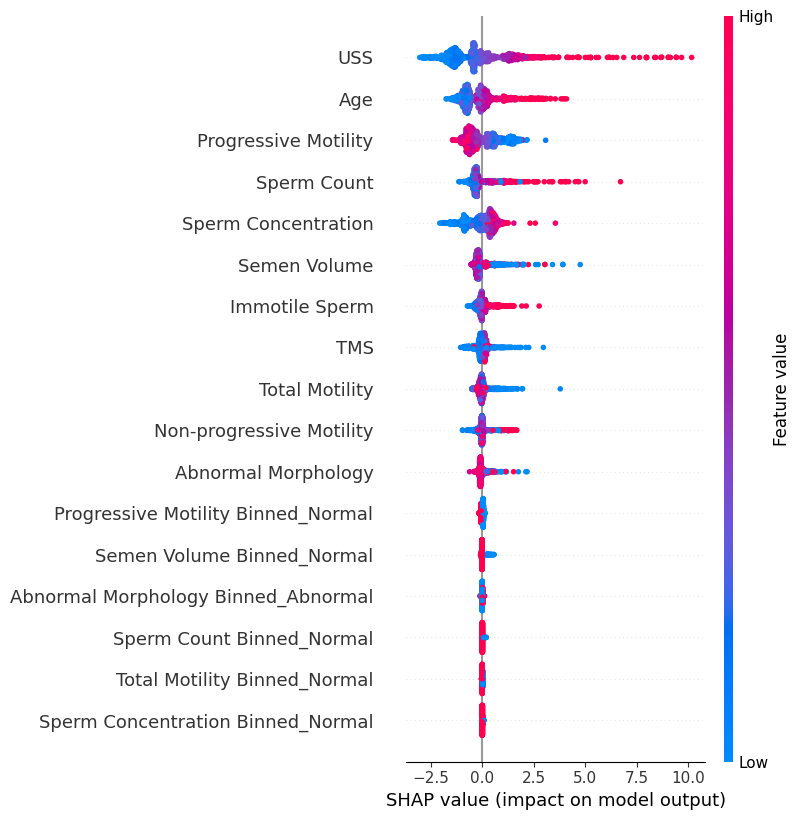

Explaining target 1...


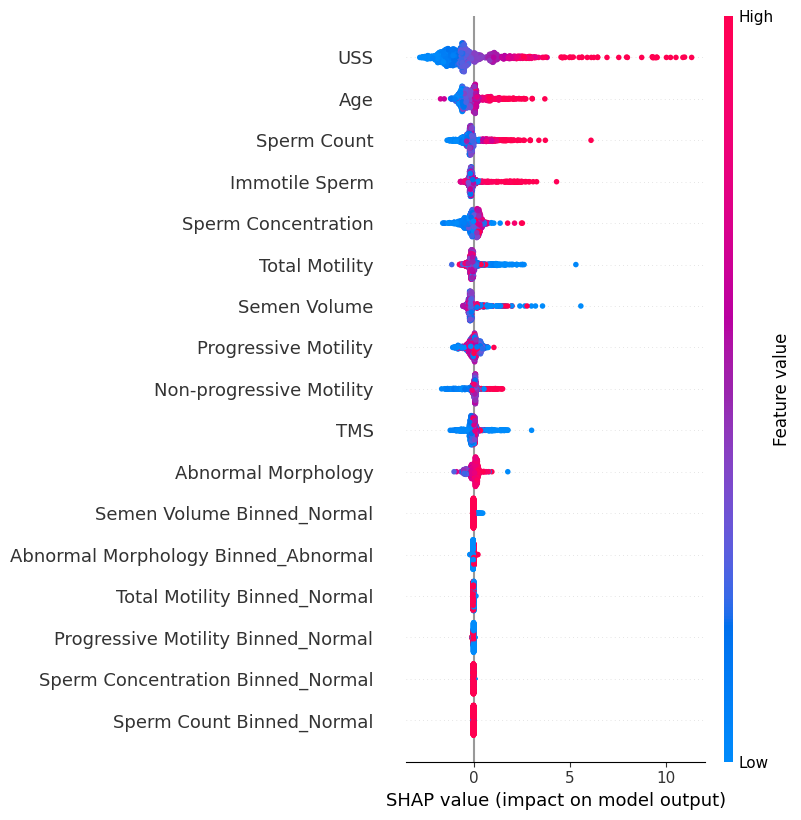

In [ ]:
for i, target_model in enumerate(model_xgb.estimators_):
    print(f"Explaining target {i}...")

    explainer = shap.Explainer(target_model, X_test_clean)
    shap_values = explainer(X_test_clean)

    shap.summary_plot(shap_values, X_test_clean, show=False)  # <- IMPORTANT: show=False

    # Save the current figure
    plt.gcf().savefig(f'shap_summary_plot_reg{i}.png', dpi=400, bbox_inches='tight')
    plt.show()

Explaining target 0...


 99%|===================| 990/1000 [01:52<00:01]       

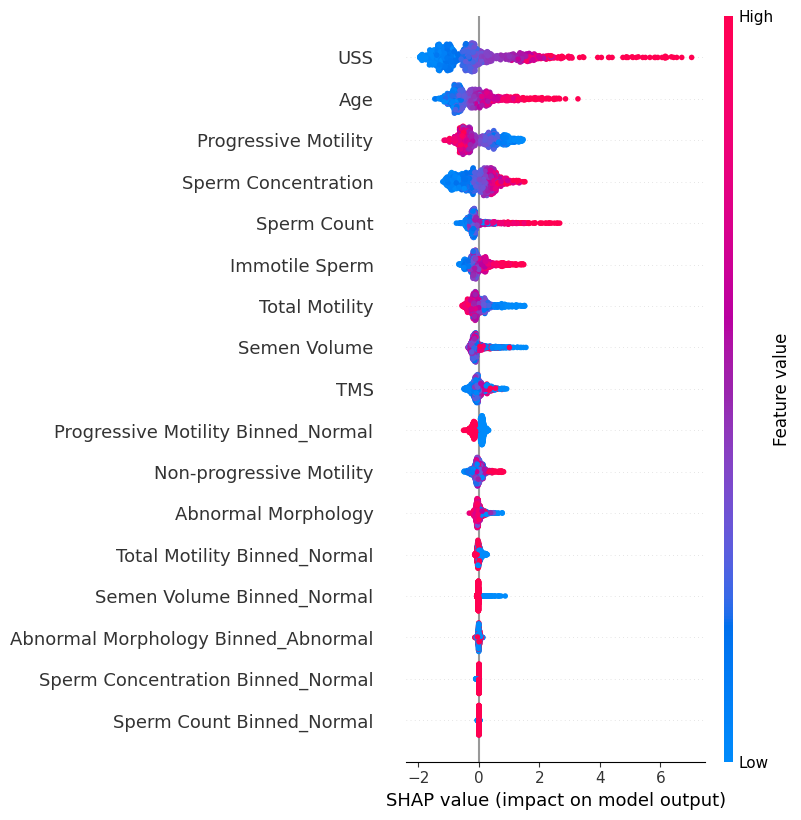

Explaining target 1...


 99%|===================| 992/1000 [01:46<00:00]       

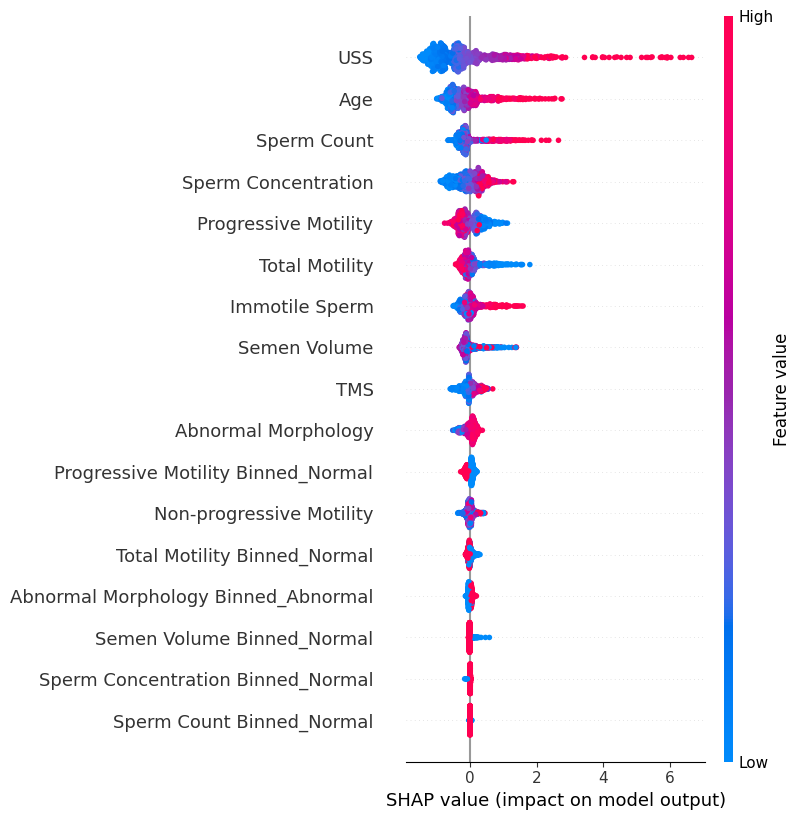

In [ ]:
for i, target_model in enumerate(model_rf.estimators_):
    print(f"Explaining target {i}...")

    explainer = shap.Explainer(target_model, X_test_clean)
    shap_values = explainer(X_test_clean)

    shap.summary_plot(shap_values, X_test_clean, show=False)  # <- IMPORTANT: show=False

    # Save the current figure
    plt.gcf().savefig(f'shap_summary_plot_rf{i}.png', dpi=400, bbox_inches='tight')
    plt.show()
